In [1]:
import os

os.environ['XLA_PYTHON_CLIENT_PREALLOCATE'] = 'false'
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
from pathlib import Path
root_path = Path.cwd().parent.absolute()
import sys
sys.path.append(str(root_path))
import os

In [2]:

from flax import nnx
import jax
from jax._src.tree_util import tree_structure
import jax.numpy as jnp
from jaxtyping import Array

In [3]:
jax.devices()

[CudaDevice(id=0)]

In [4]:
from architectures.node import NeuralODE
from architectures.utils_node import eval_model
from architectures.architectures import MLP,ResNet
from geometry.G_matrix import G_matrix
from functionals.functions import create_potentials
from functionals.linear_funcitonal_class import LinearPotential
from functionals.internal_functional_class import InternalPotential
from functionals.functional import Potential
from flows.gradient_flow import run_gradient_flow
from flows.visualization import visualize_gradient_flow_results


In [5]:
jax.devices()
device = 0

In [6]:
# Create potentials
potentials = create_potentials()

In [7]:
class parametric_model(nnx.Module):
    def __init__(self,model: nnx.Module):
        
        self.model = model
    
    def __call__(self, samples,params):

        graphdef,_ = nnx.split(self.model)
        model = nnx.merge(graphdef,params)

        return model(samples)
        

In [71]:
# Gradient flow parameters
h = 5e-4 # Time step size
max_iterations = 250
tolerance = 1e-8
n_samples = 2_000  # Monte Carlo sample size


key = jax.random.PRNGKey(1234)
rngs = nnx.Rngs(key)

################## Create NODE model
# If the node is time dependent do d +1 for din
model = MLP(din=3, num_layers=1, width_layers=128, dout=2, 
                         activation_fn="tanh", rngs=rngs)
gradient_flow_model = NeuralODE(
    dynamics_model=model,
    solver = 'heun',
    time_dependent=True,
    dt0=0.2,
)
#################### ResNet model
# model = ResNet(din=2,num_layers=2,width_layers=32,dout=2,activation_fn='tanh',rngs=rngs)
# gradient_flow_model = parametric_model(model=model)

# Set parameters to be very small (near zero)
_, initial_params = nnx.split(gradient_flow_model)
scale_factor = 1e-2  # Small scaling to keep near identity

# Scale all parameters to be small
small_params = jax.tree.map(lambda p: p * scale_factor, initial_params)

# Merge back into the node
graphdef, _ = nnx.split(gradient_flow_model)
gradient_flow_model = nnx.merge(graphdef, small_params)

# Generate reference samples from λ = N(0, I)
key, subkey = jax.random.split(key)
z_samples = jax.random.normal(subkey, (n_samples, 2))

G_mat_flow = G_matrix(gradient_flow_model)
# Options: quadratic, double_well, strong_double_well,quartic,four_well,strong_four_well

solver= 'cg'


In [72]:
from functionals.functions import double_well_potential_fn,styblinski_tang_potential_fn
linear_potential = LinearPotential(potential_fn= styblinski_tang_potential_fn, coeff = 2.0)
internal_potential = InternalPotential(functional='entropy', coeff = 1.0, method= 'exact',prob_dim=2)

potential = Potential(linear = linear_potential,
                      internal = internal_potential,
                      interaction = None)

Selected device: cuda:0


Gradient Flow Progress:   4%|▍         | 10/249 [00:38<12:15,  3.08s/it, Energy=-28.684238, Linear=-25.907404, Internal=-2.776834, Interaction=0.000000]

Iter  10: Energy = -28.684238, Grad norm: 5.32e+01


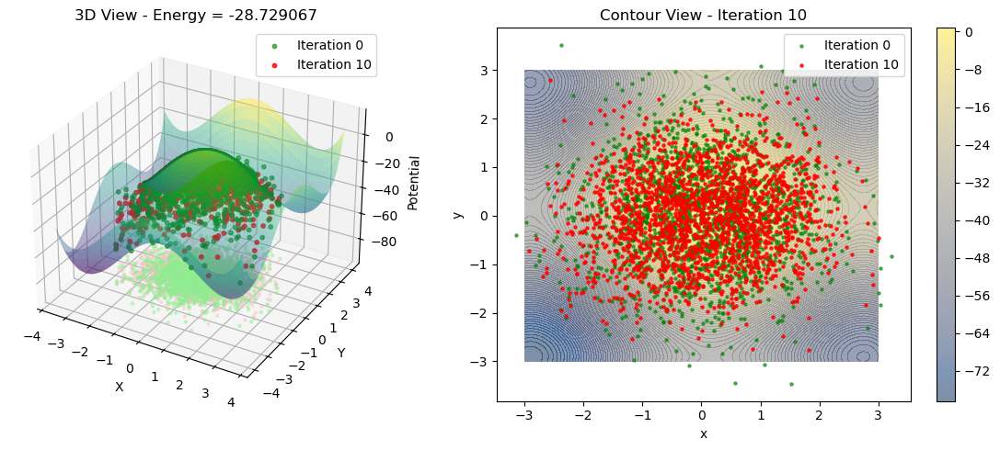

Gradient Flow Progress:   8%|▊         | 20/249 [01:09<11:34,  3.03s/it, Energy=-34.685184, Linear=-31.722443, Internal=-2.962741, Interaction=0.000000]

Iter  20: Energy = -34.685184, Grad norm: 6.69e+01


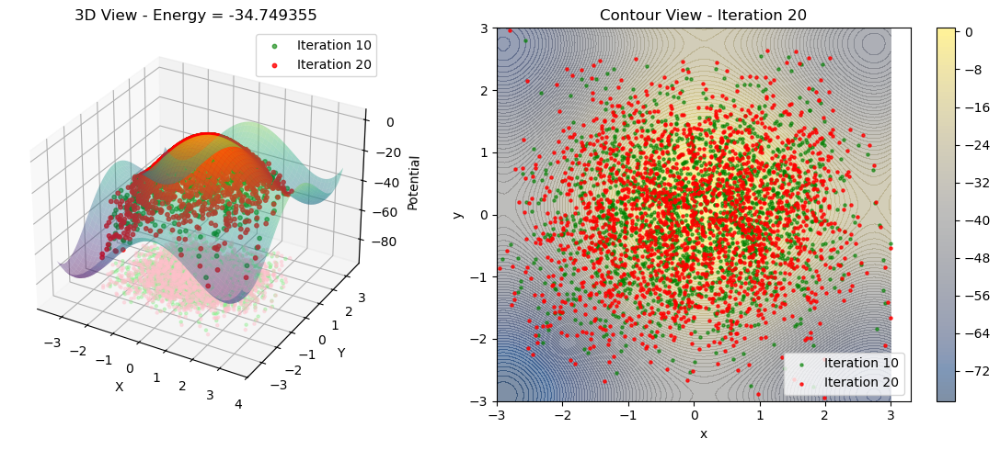

Gradient Flow Progress:  12%|█▏        | 30/249 [01:40<11:04,  3.03s/it, Energy=-41.514210, Linear=-38.392174, Internal=-3.122036, Interaction=0.000000]

Iter  30: Energy = -41.514210, Grad norm: 7.92e+01


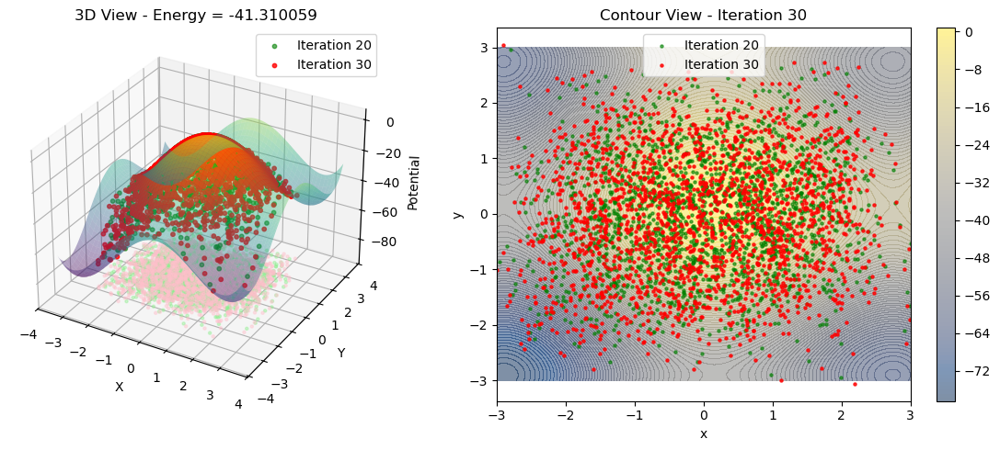

Gradient Flow Progress:  16%|█▌        | 40/249 [02:12<10:31,  3.02s/it, Energy=-49.134068, Linear=-45.887505, Internal=-3.246561, Interaction=0.000000]

Iter  40: Energy = -49.134068, Grad norm: 8.95e+01


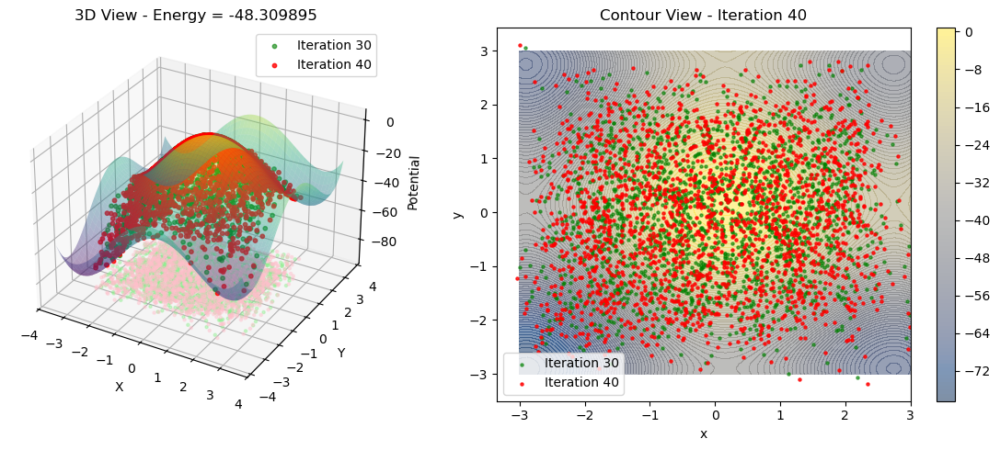

Gradient Flow Progress:  20%|██        | 50/249 [02:43<10:01,  3.02s/it, Energy=-54.172726, Linear=-50.870907, Internal=-3.301817, Interaction=0.000000]

Iter  50: Energy = -54.172726, Grad norm: 9.42e+01


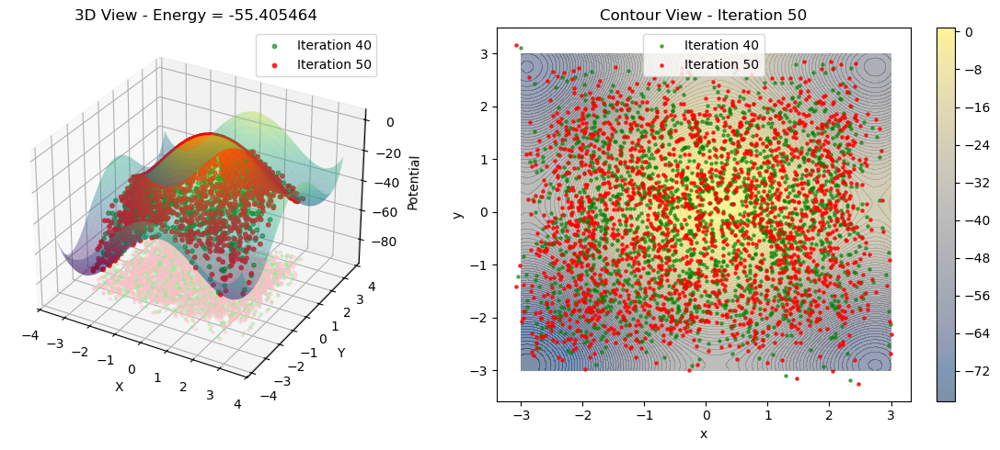

Gradient Flow Progress:  24%|██▍       | 60/249 [03:15<09:32,  3.03s/it, Energy=-61.841953, Linear=-58.500767, Internal=-3.341187, Interaction=0.000000]

Iter  60: Energy = -61.841953, Grad norm: 9.93e+01


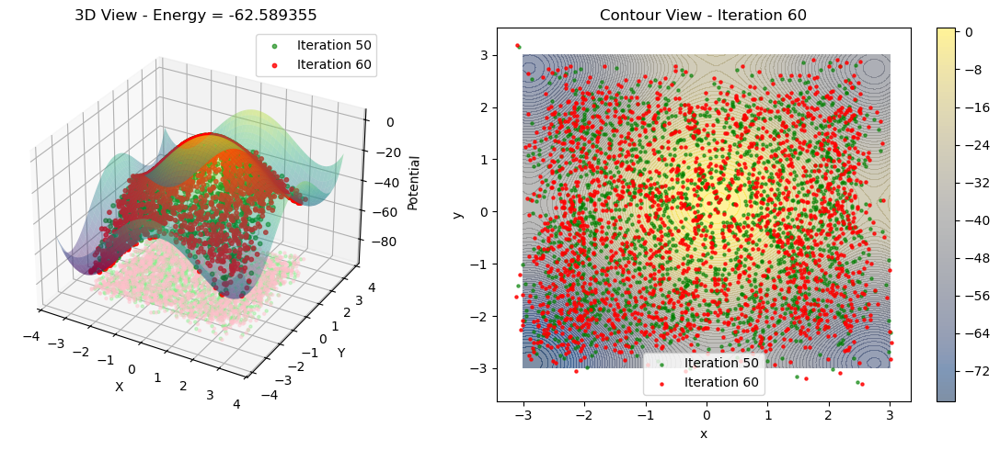

Gradient Flow Progress:  28%|██▊       | 70/249 [03:49<09:15,  3.10s/it, Energy=-68.254211, Linear=-64.951576, Internal=-3.302635, Interaction=0.000000]

Iter  70: Energy = -68.254211, Grad norm: 1.01e+02


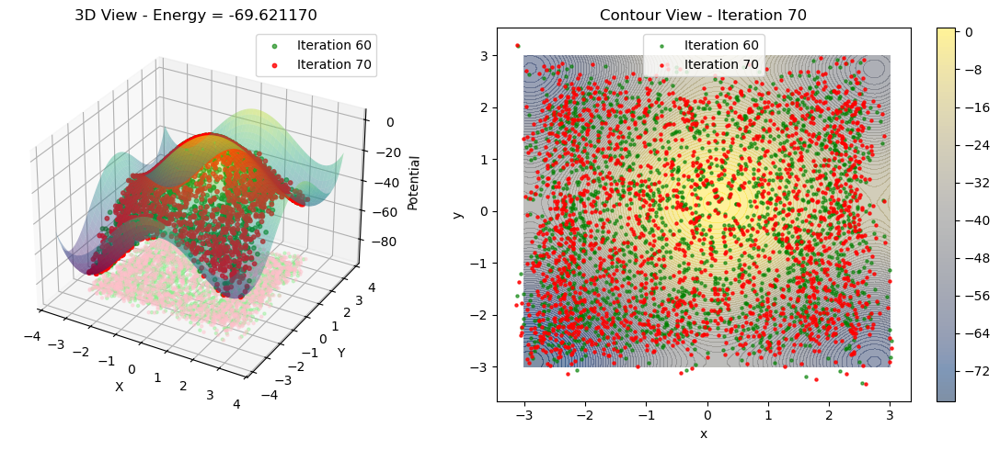

Gradient Flow Progress:  32%|███▏      | 80/249 [04:20<08:31,  3.03s/it, Energy=-75.767349, Linear=-72.495552, Internal=-3.271799, Interaction=0.000000]

Iter  80: Energy = -75.767349, Grad norm: 1.00e+02


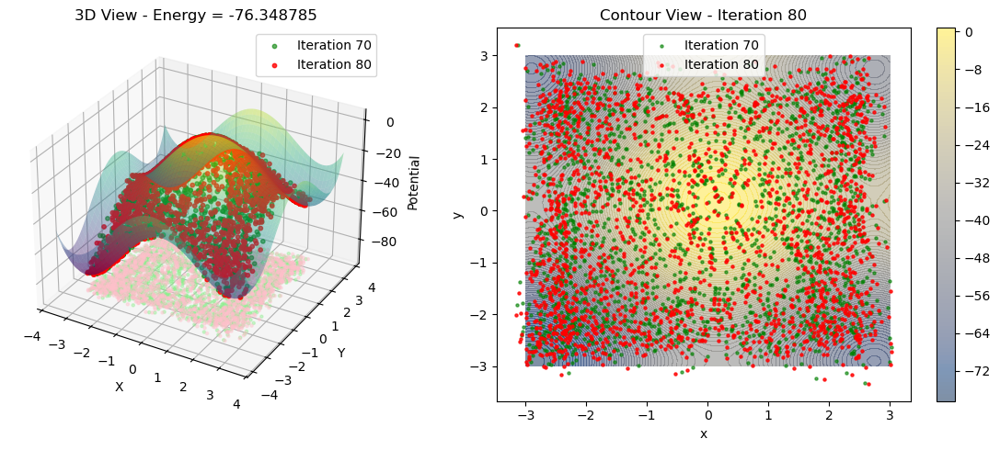

Gradient Flow Progress:  36%|███▌      | 90/249 [04:52<08:00,  3.02s/it, Energy=-81.104881, Linear=-77.920647, Internal=-3.184232, Interaction=0.000000]

Iter  90: Energy = -81.104881, Grad norm: 9.79e+01


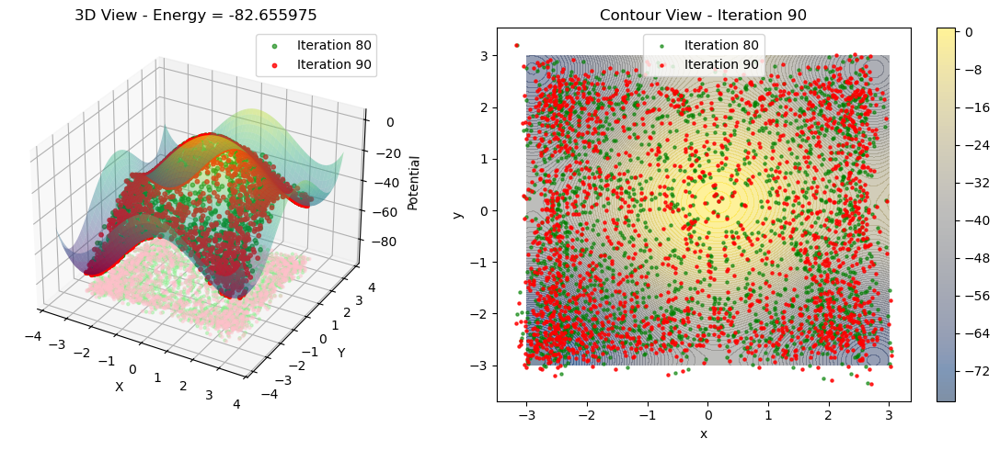

Gradient Flow Progress:  40%|████      | 100/249 [05:23<07:31,  3.03s/it, Energy=-90.278160, Linear=-87.283699, Internal=-2.994464, Interaction=0.000000]

Iter 100: Energy = -90.278160, Grad norm: 9.29e+01


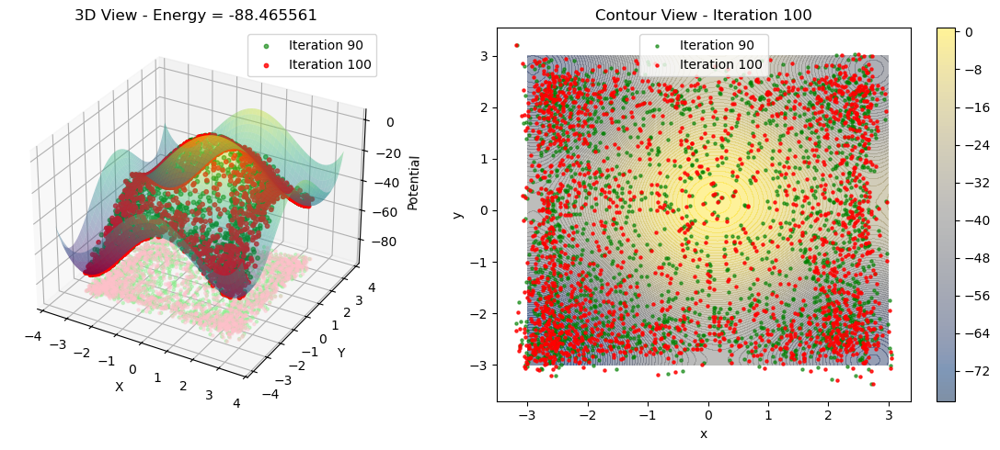

Gradient Flow Progress:  44%|████▍     | 110/249 [05:55<07:05,  3.06s/it, Energy=-94.252014, Linear=-91.391289, Internal=-2.860725, Interaction=0.000000]

Iter 110: Energy = -94.252014, Grad norm: 8.94e+01


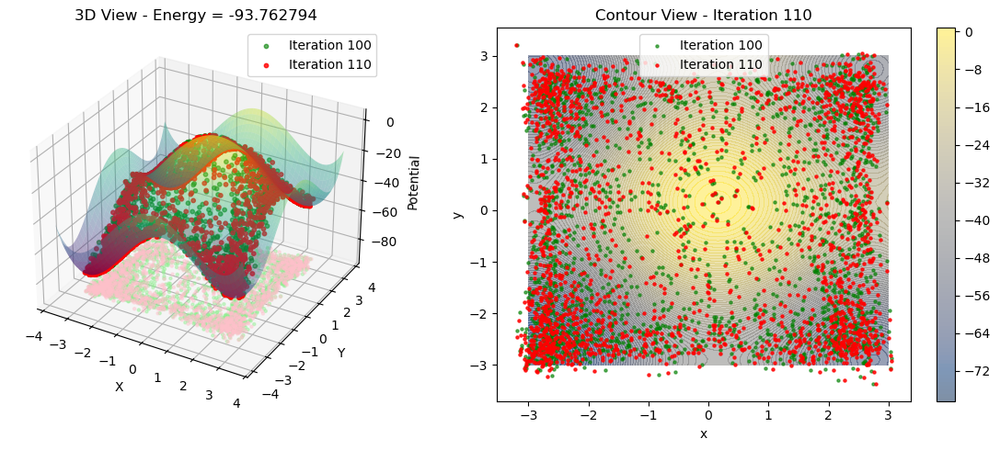

Gradient Flow Progress:  48%|████▊     | 120/249 [06:27<06:36,  3.07s/it, Energy=-98.164848, Linear=-95.492126, Internal=-2.672724, Interaction=0.000000]

Iter 120: Energy = -98.164848, Grad norm: 8.12e+01


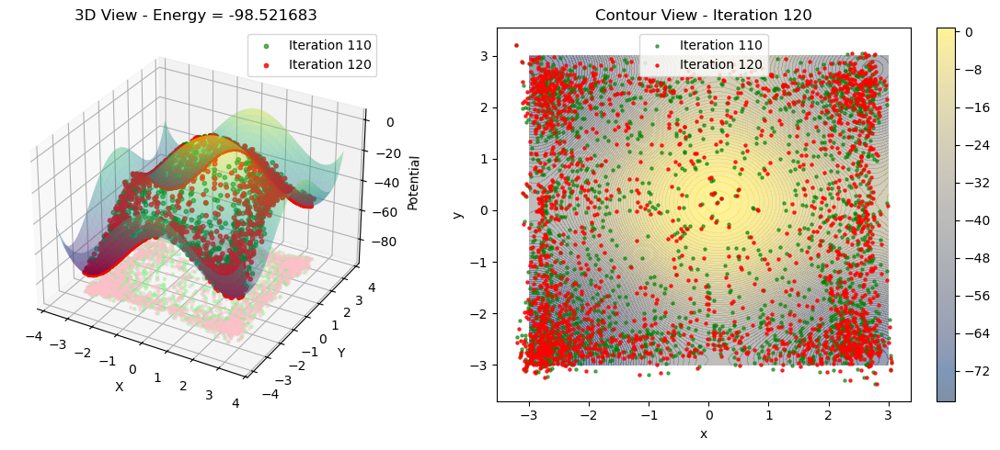

Gradient Flow Progress:  52%|█████▏    | 130/249 [06:59<06:04,  3.07s/it, Energy=-103.373848, Linear=-100.932800, Internal=-2.441045, Interaction=0.000000]

Iter 130: Energy = -103.373848, Grad norm: 7.47e+01


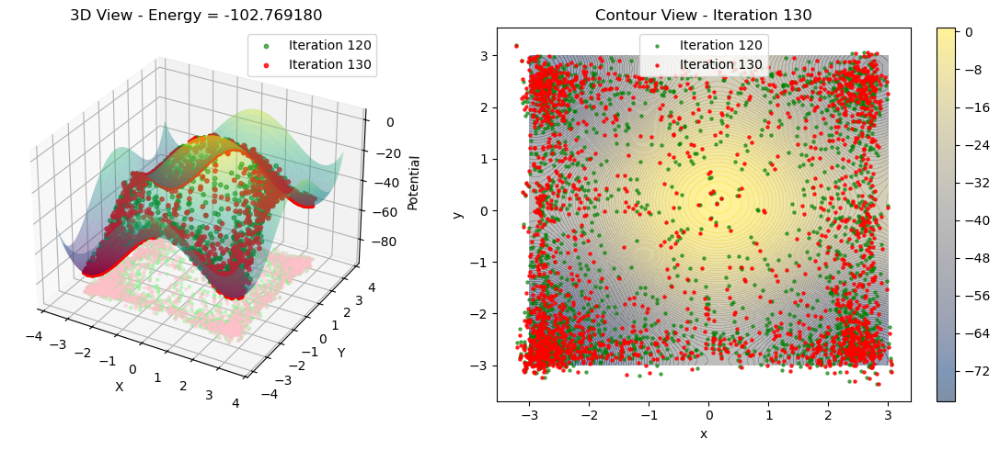

Gradient Flow Progress:  56%|█████▌    | 140/249 [07:31<05:39,  3.11s/it, Energy=-106.069542, Linear=-103.872826, Internal=-2.196719, Interaction=0.000000]

Iter 140: Energy = -106.069542, Grad norm: 6.70e+01


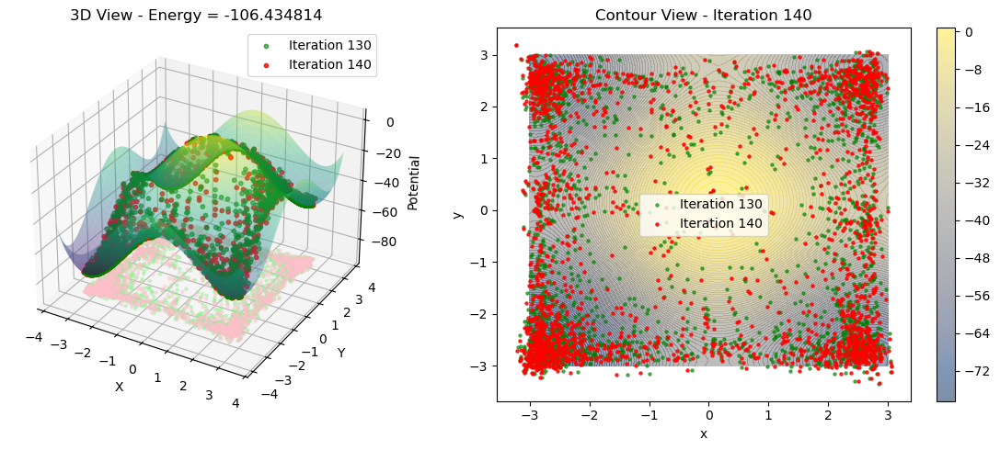

Gradient Flow Progress:  60%|██████    | 150/249 [08:02<05:02,  3.05s/it, Energy=-109.897026, Linear=-107.985939, Internal=-1.911089, Interaction=0.000000]

Iter 150: Energy = -109.897026, Grad norm: 5.82e+01


/work/Sebas/miniconda3/envs/BV_Hamiltonian/lib/python3.13/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


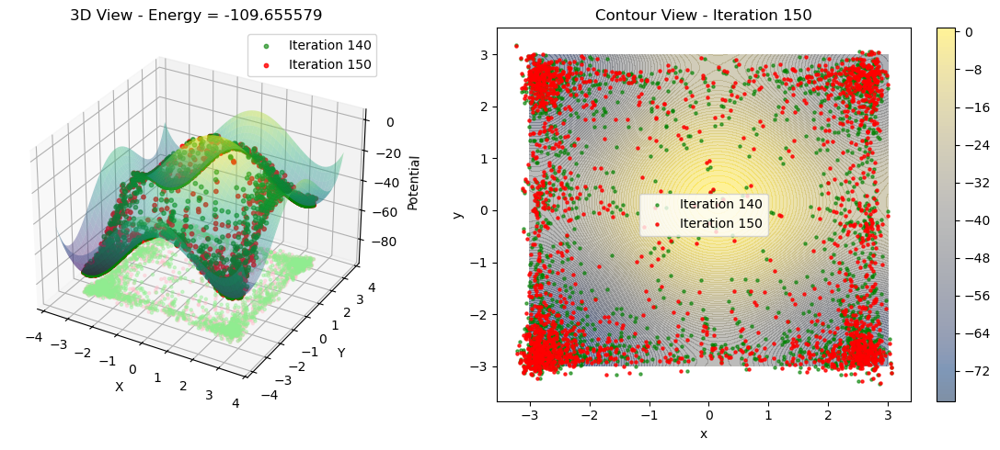

Gradient Flow Progress:  64%|██████▍   | 160/249 [08:37<04:40,  3.15s/it, Energy=-112.210815, Linear=-110.456772, Internal=-1.754047, Interaction=0.000000]

Iter 160: Energy = -112.210815, Grad norm: 5.54e+01


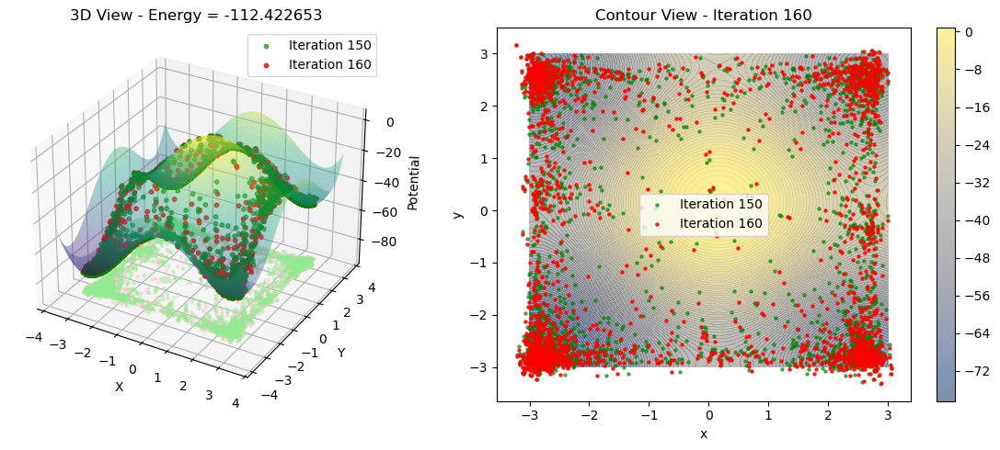

Gradient Flow Progress:  68%|██████▊   | 170/249 [09:09<04:06,  3.12s/it, Energy=-114.451668, Linear=-112.981133, Internal=-1.470536, Interaction=0.000000]

Iter 170: Energy = -114.451668, Grad norm: 4.74e+01


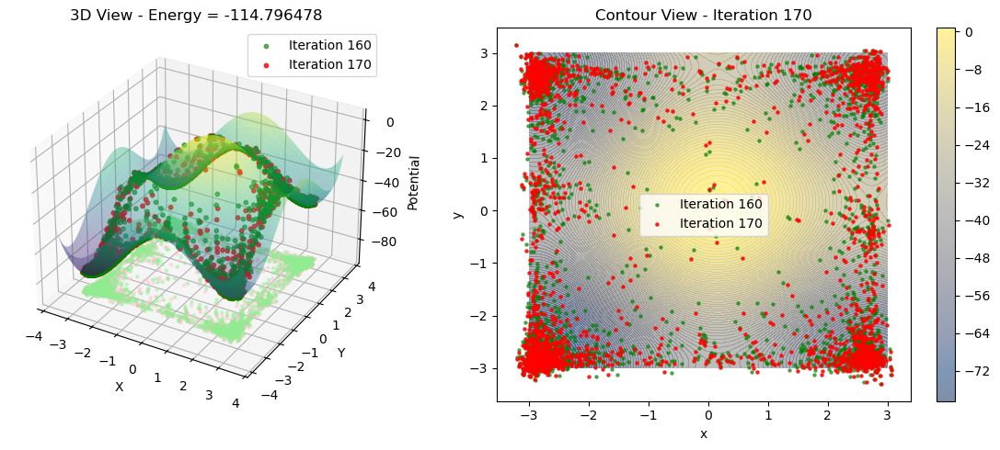

Gradient Flow Progress:  72%|███████▏  | 180/249 [09:41<03:30,  3.05s/it, Energy=-117.165253, Linear=-115.935883, Internal=-1.229370, Interaction=0.000000]

Iter 180: Energy = -117.165253, Grad norm: 5.14e+01


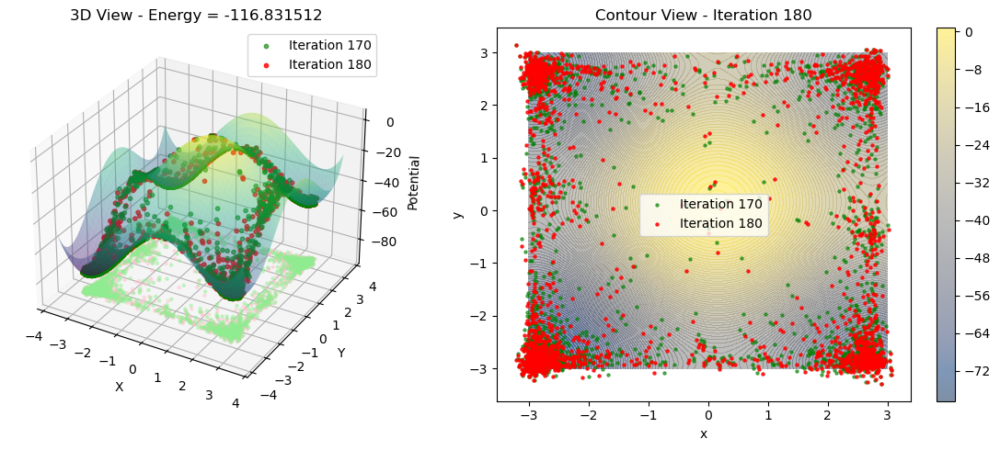

Gradient Flow Progress:  76%|███████▋  | 190/249 [10:14<03:07,  3.18s/it, Energy=-119.802002, Linear=-118.847160, Internal=-0.954840, Interaction=0.000000]

Iter 190: Energy = -119.802002, Grad norm: 3.89e+01


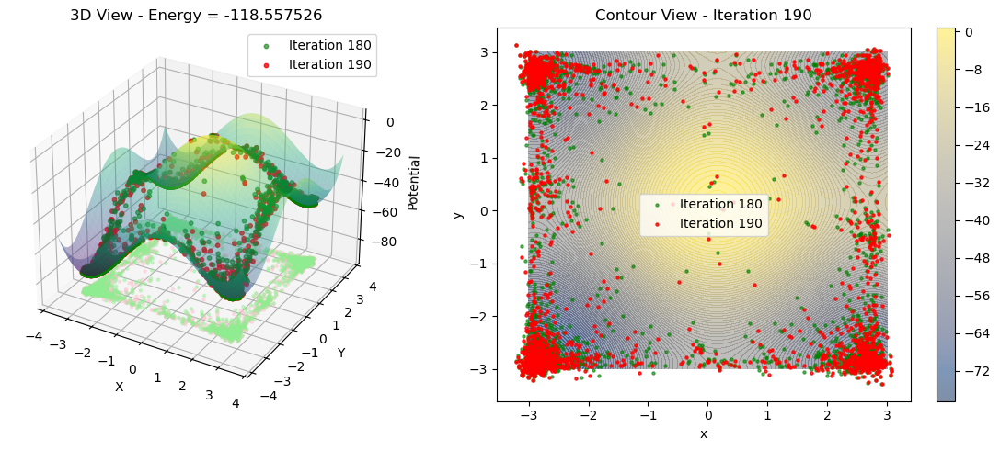

Gradient Flow Progress:  80%|████████  | 200/249 [10:46<02:30,  3.08s/it, Energy=-119.863556, Linear=-119.046814, Internal=-0.816743, Interaction=0.000000]

Iter 200: Energy = -119.863556, Grad norm: 3.94e+01


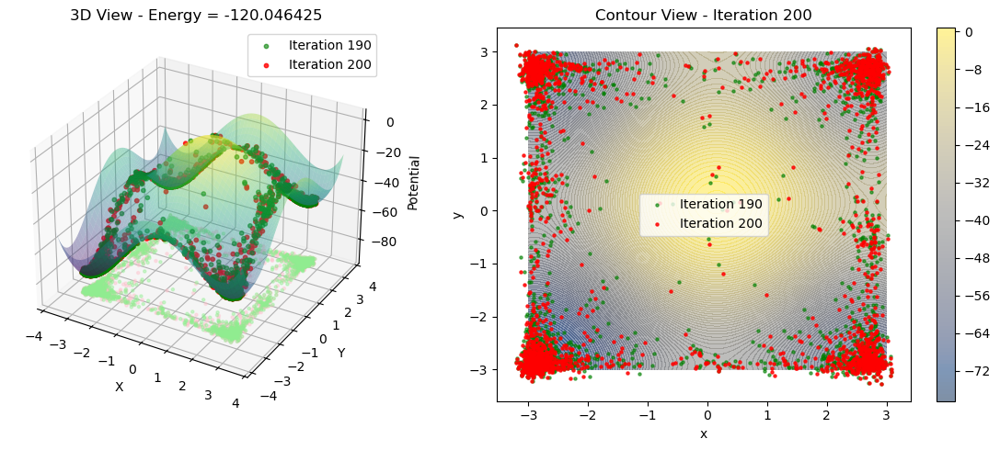

Gradient Flow Progress:  84%|████████▍ | 210/249 [11:18<01:58,  3.04s/it, Energy=-121.642616, Linear=-120.962616, Internal=-0.679999, Interaction=0.000000]

Iter 210: Energy = -121.642616, Grad norm: 3.25e+01


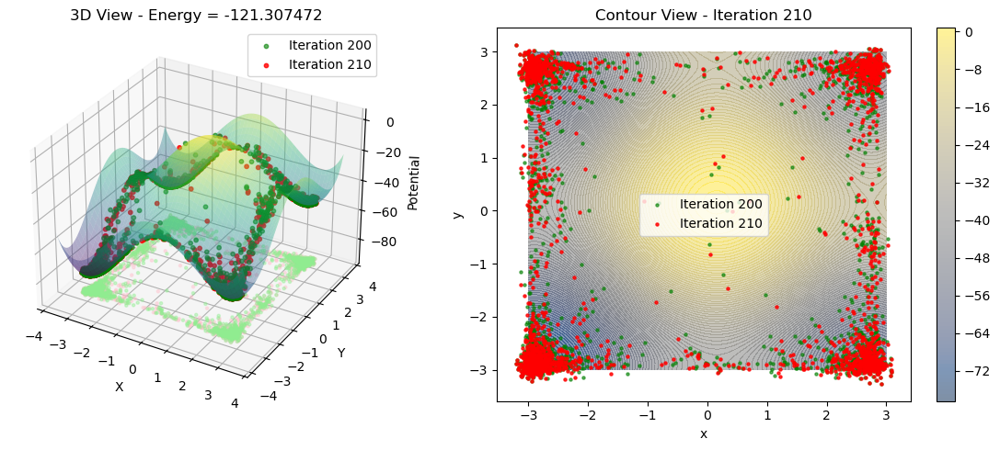

Gradient Flow Progress:  88%|████████▊ | 220/249 [11:49<01:27,  3.02s/it, Energy=-122.851059, Linear=-122.369537, Internal=-0.481521, Interaction=0.000000]

Iter 220: Energy = -122.851059, Grad norm: 2.83e+01


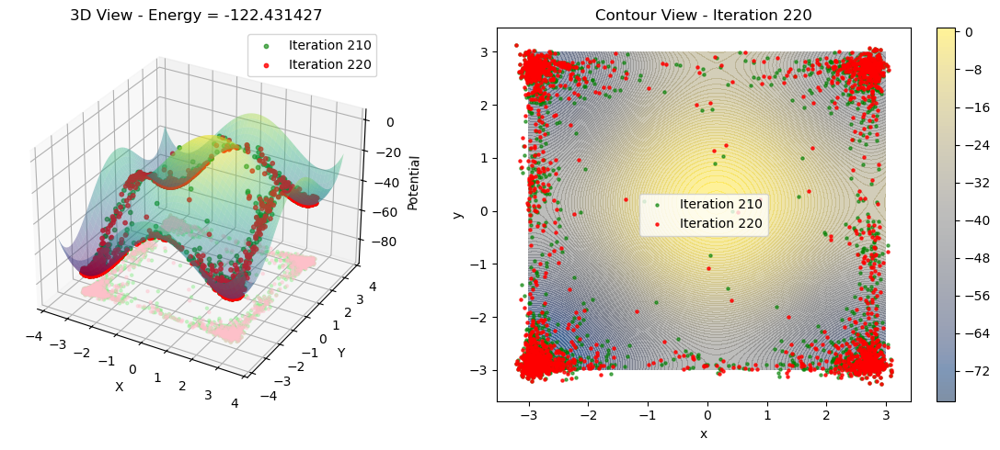

Gradient Flow Progress:  92%|█████████▏| 230/249 [12:20<00:57,  3.02s/it, Energy=-123.420456, Linear=-123.089317, Internal=-0.331138, Interaction=0.000000]

Iter 230: Energy = -123.420456, Grad norm: 3.90e+01


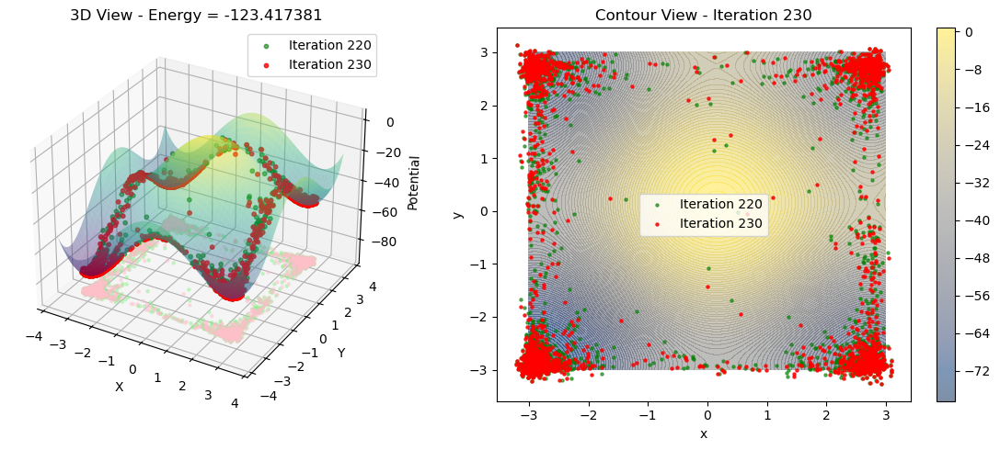

Gradient Flow Progress:  96%|█████████▋| 240/249 [12:52<00:27,  3.03s/it, Energy=-123.821442, Linear=-123.583839, Internal=-0.237601, Interaction=0.000000]

Iter 240: Energy = -123.821442, Grad norm: 2.93e+01


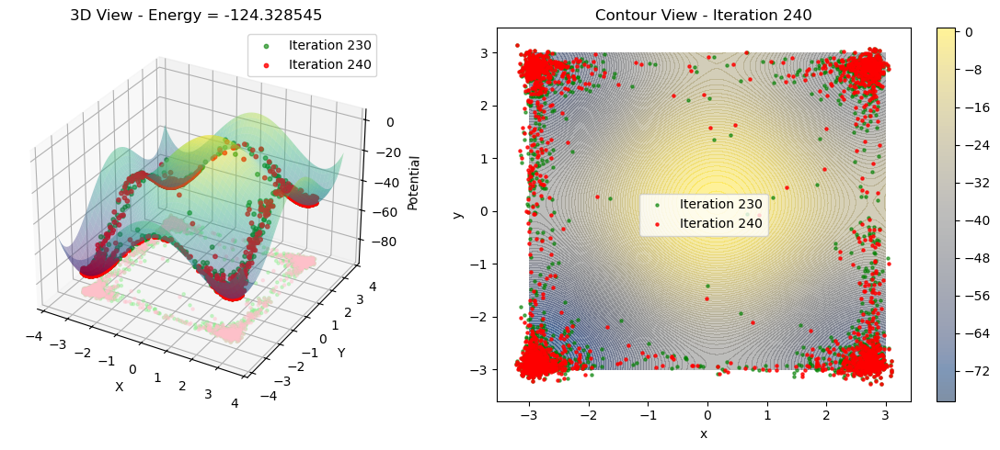

Gradient Flow Progress: 100%|█████████▉| 248/249 [13:19<00:03,  3.37s/it, Energy=-125.630867, Linear=-125.528259, Internal=-0.102606, Interaction=0.000000]

Iter 248: Energy = -125.630867, Grad norm: 2.07e+01


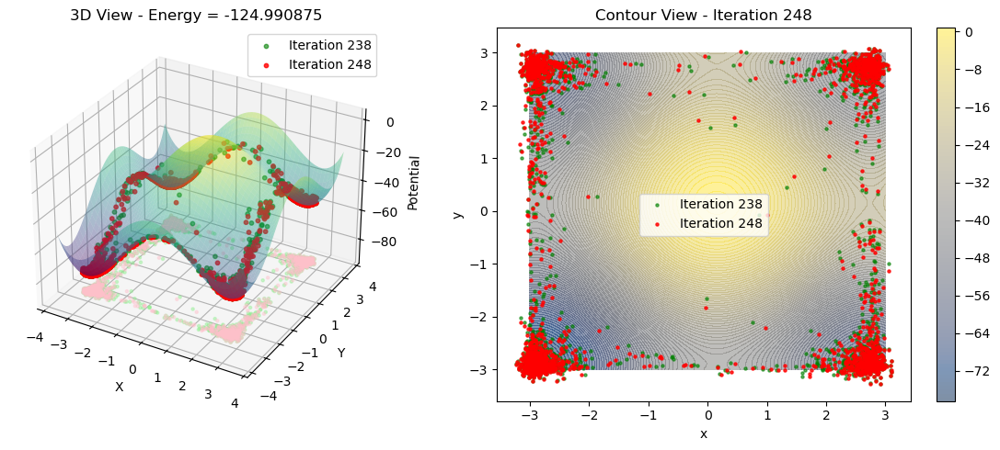

Gradient Flow Progress: 100%|██████████| 249/249 [13:20<00:00,  3.22s/it, Energy=-125.630867, Linear=-125.528259, Internal=-0.102606, Interaction=0.000000]


=== Integration Complete ===
Total iterations:    248
Initial energy:      -29.751795
Final energy:        -125.630867
Total decrease:      95.879072
Reduction ratio:     4.2226
Final param norm:    11.426477


In [73]:

results = run_gradient_flow(
    gradient_flow_model, z_samples, G_mat_flow,
    potential,device_idx=device
    ,solver=solver,
    h=h, max_iterations=max_iterations, tolerance=tolerance,
    progress_every=10
)

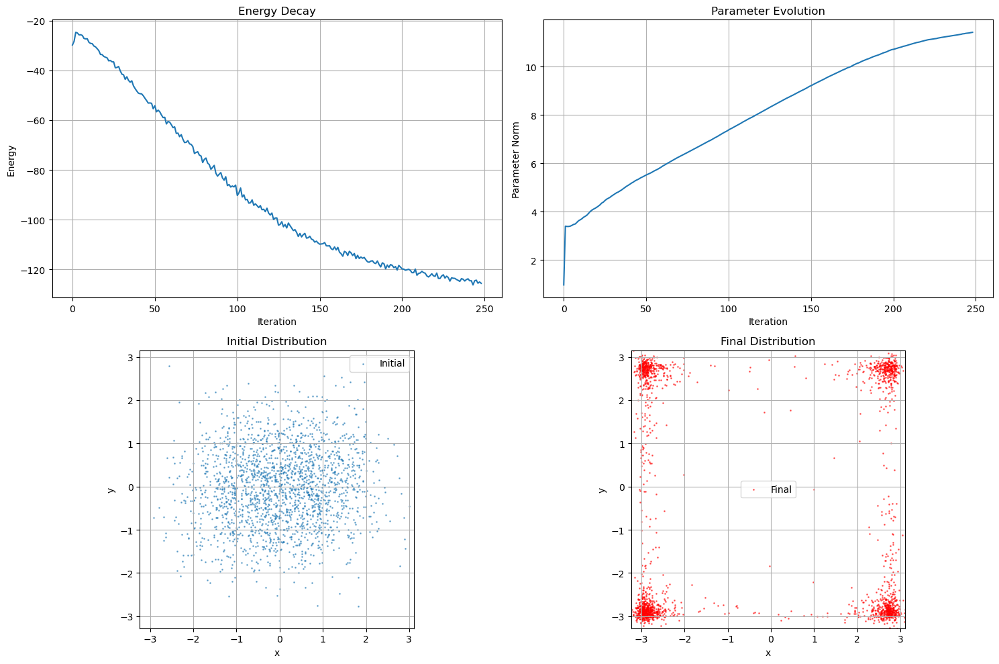

In [74]:
# Visualize results
visualize_gradient_flow_results(results)

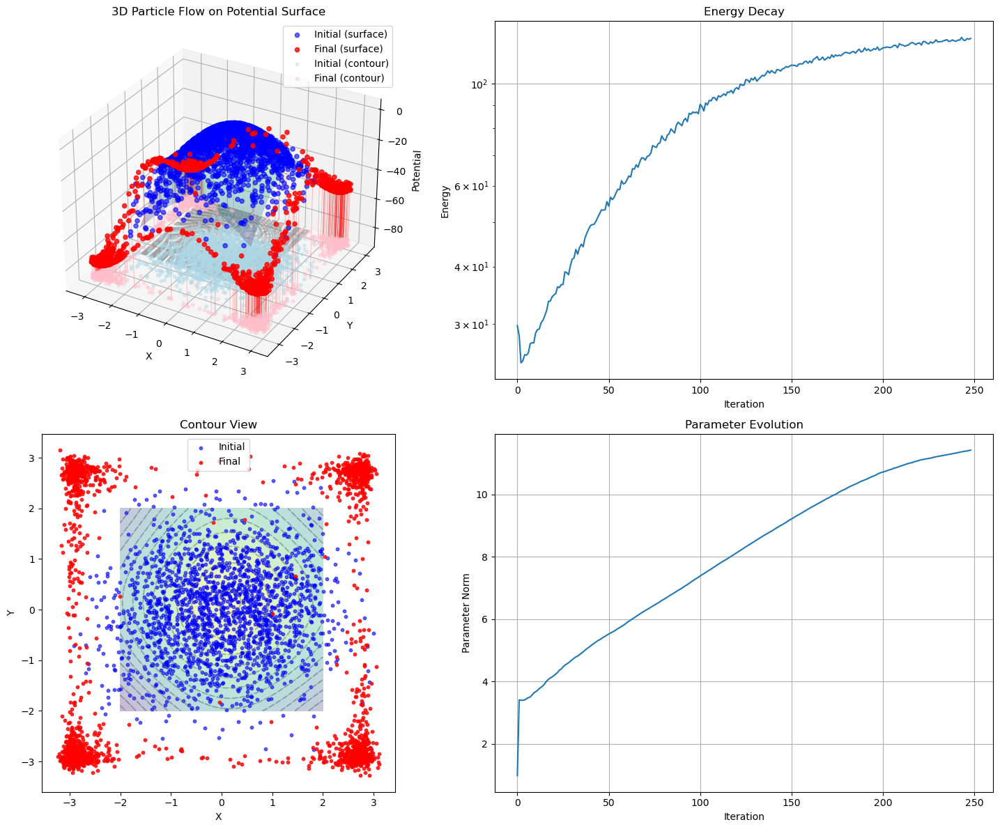

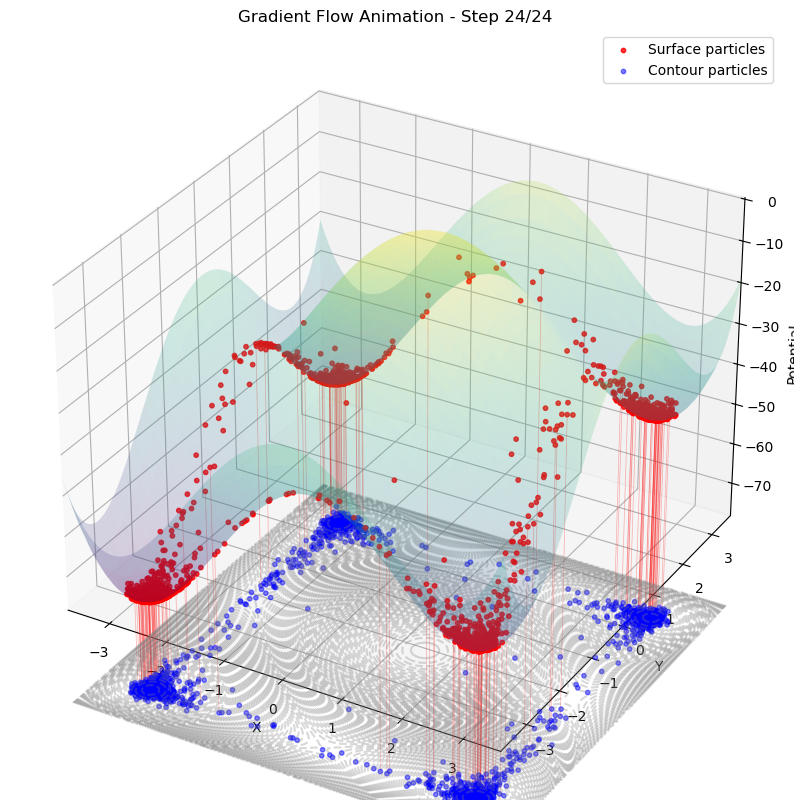

In [75]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

def visualize_gradient_flow_3d(results: dict, potential: Potential, figsize: tuple = (15, 12), x_range=None, y_range=None):
    """
    Enhanced 3D visualization showing particles on potential surface and contour plane
    
    Args:
        results: Results dictionary from run_gradient_flow
        potential_func: Function that takes (x, y) and returns potential value
        figsize: Figure size for plots
    """
    fig = plt.figure(figsize=figsize)
    
    # Create 3D subplot
    ax_3d = fig.add_subplot(221, projection='3d')
    
    # Get particle data
    initial_samples = results['sample_history'][0]
    final_samples = results['sample_history'][-1]
    
    # Create potential surface mesh
    if x_range is None:
        x_range = jnp.linspace(initial_samples[:,0].min() - 0.5, initial_samples[:,0].max() + 0.5, 100)
    if y_range is None:
        y_range = jnp.linspace(initial_samples[:,1].min() - 0.5, initial_samples[:,1].max() + 0.5, 100)
    # x_range = jnp.linspace(initial_samples[:,0].min() , initial_samples[:,0].max(), 100)
    # y_range = jnp.linspace(initial_samples[:,1].min() , initial_samples[:,1].max(), 100)
    X, Y = jnp.meshgrid(x_range, y_range)
    Z = jnp.zeros_like(X)

    # Evaluate potential on mesh
    Z = potential.linear.potential_fn(jnp.stack([X.ravel(), Y.ravel()], axis=-1),**potential.linear.potential_kwargs).reshape(X.shape)

    base_z = Z.min() - 0.3 * (Z.max() - Z.min())
    # base_x = X.min() - 0.3 * (X.max() - X.min())
    # base_y = Y.min() - 0.3 * (Y.max() - Y.min())

    # Plot potential surface
    ax_3d.plot_surface(X, Y, Z, cmap='viridis', antialiased=True,alpha = 0.3) #
    ax_3d.contour(X, Y, Z,zdir ='z', offset=base_z, levels=150, colors='gray', alpha=0.3)
    # ax_3d.contour(X, Y, Z,zdir ='y',levels = 150,alhpa = 0.3,cmap='viridis')
    # ax_3d.contour(X, Y, Z,zdir ='x',levels = 150,alhpa = 0.3,cmap='viridis')

    # Plot particles at surface level (elevated by potential value)
    # surface_z_initial = np.array([potential_func(x, y) for x, y in initial_samples])
    # surface_z_final = np.array([potential_func(x, y) for x, y in final_samples])
    surface_z_initial = potential.linear.potential_fn(jnp.array(initial_samples),**potential.linear.potential_kwargs)
    surface_z_final = potential.linear.potential_fn(jnp.array(final_samples),**potential.linear.potential_kwargs)

    
    # Surface particles
    ax_3d.scatter(initial_samples[:,0], initial_samples[:,1], surface_z_initial, 
                  c='blue', s=20, alpha=0.6, label='Initial (surface)')
    ax_3d.scatter(final_samples[:,0], final_samples[:,1], surface_z_final, 
                  c='red', s=20, alpha=0.8, label='Final (surface)')
    
    # Contour particles (at base level)
    base_z = Z.min() - 0.5 * (Z.max() - Z.min())
    ax_3d.scatter(initial_samples[:,0], initial_samples[:,1], base_z, 
                  c='lightblue', s=10, alpha=0.4, label='Initial (contour)')
    ax_3d.scatter(final_samples[:,0], final_samples[:,1], base_z, 
                  c='pink', s=10, alpha=0.4, label='Final (contour)')
    
    # Add drop lines for final particles
    for i in range(0, len(final_samples), 5):  # Show every 5th particle to avoid clutter
        x, y = final_samples[i]
        z_surf = surface_z_final[i]
        ax_3d.plot([x, x], [y, y], [base_z, z_surf], 'r-', alpha=0.3, linewidth=0.5)
    
    ax_3d.set_xlabel('X')
    ax_3d.set_ylabel('Y')
    ax_3d.set_zlabel('Potential')
    ax_3d.set_title('3D Particle Flow on Potential Surface')
    ax_3d.legend()
    
    # Energy decay plot
    ax_energy = fig.add_subplot(222)
    ax_energy.plot(abs(jnp.array(results['energy_history'])))
    ax_energy.set_xlabel('Iteration')
    ax_energy.set_ylabel('Energy')
    ax_energy.set_title('Energy Decay')
    ax_energy.grid(True)
    ax_energy.set_yscale('log')
    
    # 2D contour plot with particles
    ax_contour = fig.add_subplot(223)
    contour = ax_contour.contour(X, Y, Z, levels=15, colors='gray', alpha=0.5)
    ax_contour.contourf(X, Y, Z, levels=15, alpha=0.3, cmap='viridis')
    ax_contour.scatter(initial_samples[:,0], initial_samples[:,1], 
                      c='blue', s=10, alpha=0.6, label='Initial')
    ax_contour.scatter(final_samples[:,0], final_samples[:,1], 
                      c='red', s=10, alpha=0.8, label='Final')
    ax_contour.set_xlabel('X')
    ax_contour.set_ylabel('Y')
    ax_contour.set_title('Contour View')
    ax_contour.legend()
    ax_contour.set_aspect('equal')
    
    # Parameter evolution
    ax_params = fig.add_subplot(224)
    ax_params.plot(results['param_norms'])
    ax_params.set_xlabel('Iteration')
    ax_params.set_ylabel('Parameter Norm')
    ax_params.set_title('Parameter Evolution')
    ax_params.grid(True)
    
    plt.tight_layout()
    plt.show()


def animate_gradient_flow_3d(results: dict, potential, save_path=None):
    """
    Animate the 3D particle flow over time
    
    Args:
        results: Results dictionary from run_gradient_flow
        potential_func: Function that takes (x, y) and returns potential value
        save_path: Optional path to save animation as gif
    """
    from matplotlib.animation import FuncAnimation
    
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    # Create surface mesh
    sample_history = results['sample_history']
    all_samples = np.vstack(sample_history)
    
    x_range = np.linspace(all_samples[:,0].min() - 0.5, all_samples[:,0].max() + 0.5, 100)
    y_range = np.linspace(all_samples[:,1].min() - 0.5, all_samples[:,1].max() + 0.5, 100)
    X, Y = np.meshgrid(x_range, y_range)
    Z = potential.linear.potential_fn(jnp.stack([X.ravel(), Y.ravel()], axis=-1),**potential.linear.potential_kwargs).reshape(X.shape)

    # Plot static surface
    ax.plot_surface(X, Y, Z, alpha=0.4, cmap='viridis', linewidth=0)
    
    # Base level for contour particles
    base_z = Z.min() - 0.3 * (Z.max() - Z.min())
    
    def animate(frame):
        ax.clear()
        
        
        
        # Get current samples
        current_samples = sample_history[frame]
        surface_z = potential.linear.potential_fn(jnp.array(current_samples),**potential.linear.potential_kwargs)

        x_min = current_samples[:,0].min() - 0.5
        x_max = current_samples[:,0].max() + 0.5
        y_min = current_samples[:,1].min() - 0.5
        y_max = current_samples[:,1].max() + 0.5

        X, Y = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
        Z = potential.linear.potential_fn(jnp.stack([X.ravel(), Y.ravel()], axis=-1),**potential.linear.potential_kwargs).reshape(X.shape)

        base_z = Z.min() - 0.3 * (Z.max() - Z.min())

        # Redraw surface
        ax.plot_surface(X, Y, Z, alpha=0.2, cmap='viridis', linewidth=0)
        ax.contour(X, Y, Z,zdir ='z', offset=base_z, levels=150, colors='gray', alpha=0.3)
        ax.contour(X, Y, Z,zdir ='y', offset=base_z, levels=150, alpha=0.3, cmap='viridis')

        # Plot surface particles
        ax.scatter(current_samples[:,0], current_samples[:,1], surface_z, 
                  c='red', s=10, alpha=0.8, label='Surface particles')
        
        # Plot contour particles
        ax.scatter(current_samples[:,0], current_samples[:,1], base_z, 
                  c='blue', s=10, alpha=0.5, label='Contour particles')
        
        # Add some drop lines
        for i in range(0, len(current_samples), 10):
            x, y = current_samples[i]
            z_surf = surface_z[i]
            ax.plot([x, x], [y, y], [base_z, z_surf], 'r-', alpha=0.3, linewidth=0.5)
        
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Potential')
        ax.set_title(f'Gradient Flow Animation - Step {frame}/{len(sample_history)-1}')
        ax.legend()
        
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)
        # Keep consistent view
        # ax.set_xlim(x_range[0], x_range[-1])
        # ax.set_ylim(y_range[0], y_range[-1])
        ax.set_zlim(Z.min(), Z.max())
    
    anim = FuncAnimation(fig, animate, frames=len(sample_history), interval=400, blit=False)
    
    if save_path:
        anim.save(save_path, writer='pillow', fps=3)
    
    plt.show()
    return anim


# Example usage:
visualize_gradient_flow_3d(results, potential,x_range=jnp.linspace(-2,2,100),y_range=jnp.linspace(-2,2,100))  # Simple quadratic potential
anim = animate_gradient_flow_3d(results, potential, 'flow_animation.gif')

In [84]:
final_node = results['final_node']
G_mat = G_matrix(final_node)
h = 5e-4
max_iterations = 150

Selected device: cuda:0


Gradient Flow Progress:   3%|▎         | 5/149 [00:24<08:39,  3.61s/it, Energy=-125.131844, Linear=-125.013115, Internal=-0.118730, Interaction=0.000000]

Iter   5: Energy = -125.131844, Grad norm: 2.21e+01


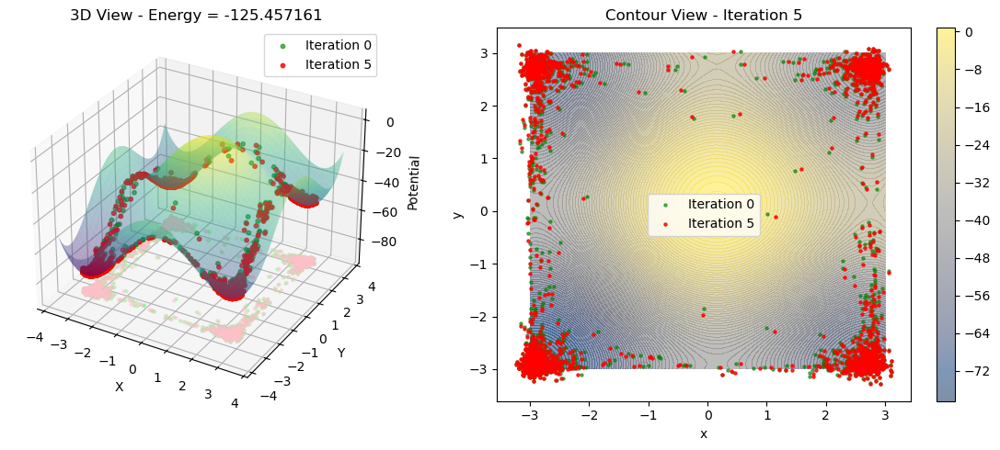

Gradient Flow Progress:   7%|▋         | 10/149 [00:41<07:48,  3.37s/it, Energy=-126.174751, Linear=-126.253059, Internal=0.078306, Interaction=0.000000] 

Iter  10: Energy = -126.174751, Grad norm: 1.75e+01


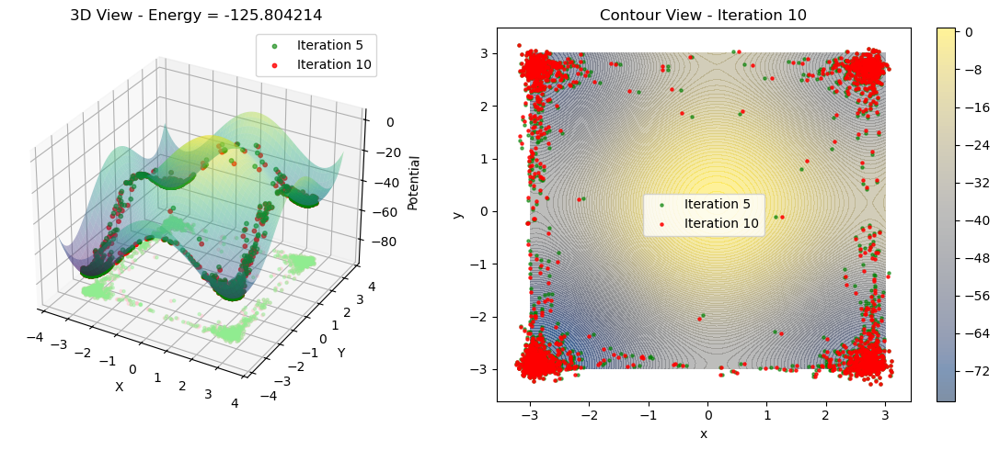

Gradient Flow Progress:  10%|█         | 15/149 [00:58<07:18,  3.27s/it, Energy=-127.638840, Linear=-127.782684, Internal=0.143843, Interaction=0.000000]

Iter  15: Energy = -127.638840, Grad norm: 2.04e+01


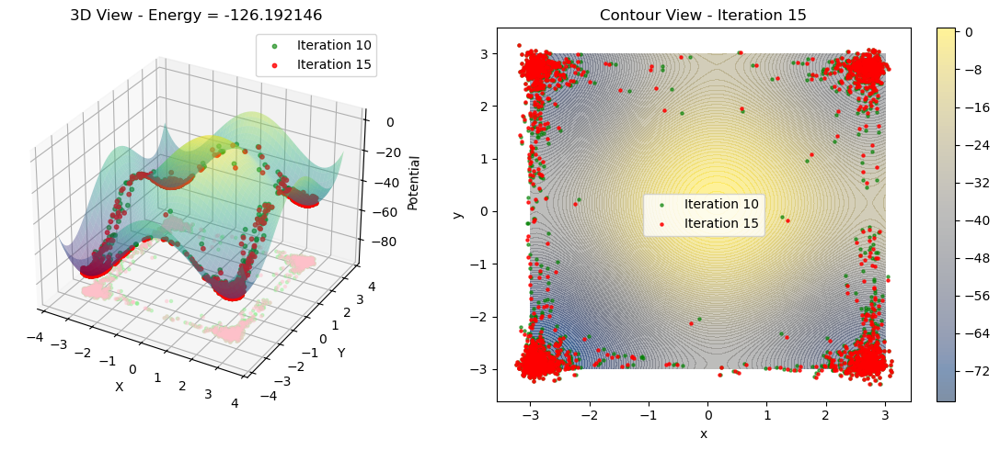

Gradient Flow Progress:  13%|█▎        | 20/149 [01:15<06:58,  3.24s/it, Energy=-126.835762, Linear=-127.040176, Internal=0.204413, Interaction=0.000000]

Iter  20: Energy = -126.835762, Grad norm: 1.80e+01


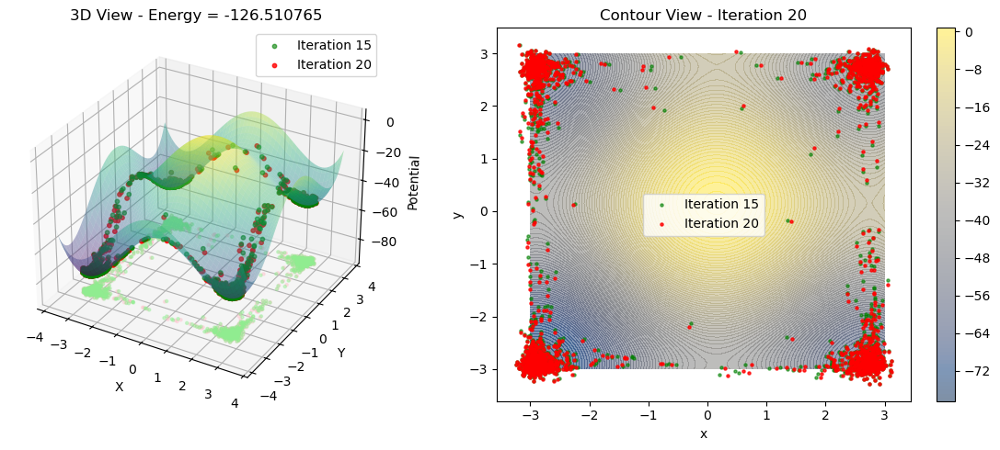

Gradient Flow Progress:  17%|█▋        | 25/149 [01:33<06:54,  3.34s/it, Energy=-126.728157, Linear=-126.946190, Internal=0.218034, Interaction=0.000000]

Iter  25: Energy = -126.728157, Grad norm: 1.91e+01


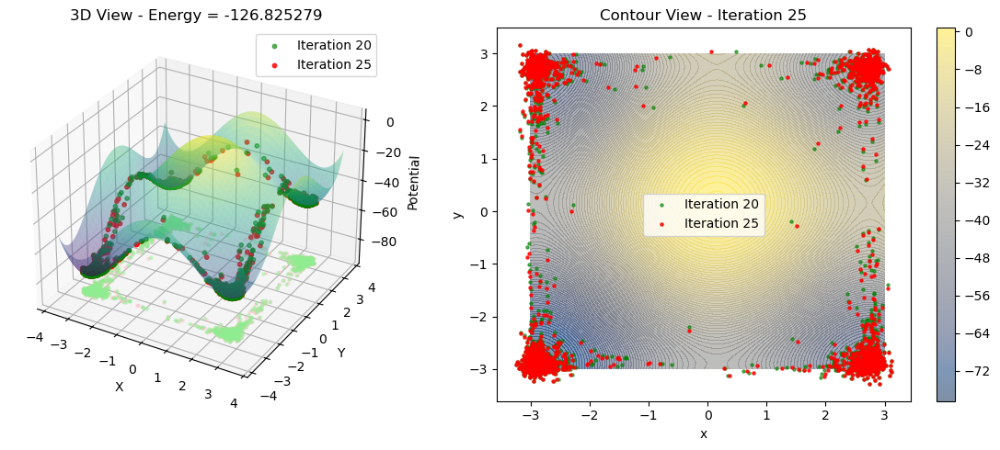

Gradient Flow Progress:  20%|██        | 30/149 [01:50<06:30,  3.28s/it, Energy=-128.038467, Linear=-128.371384, Internal=0.332915, Interaction=0.000000]

Iter  30: Energy = -128.038467, Grad norm: 2.09e+01


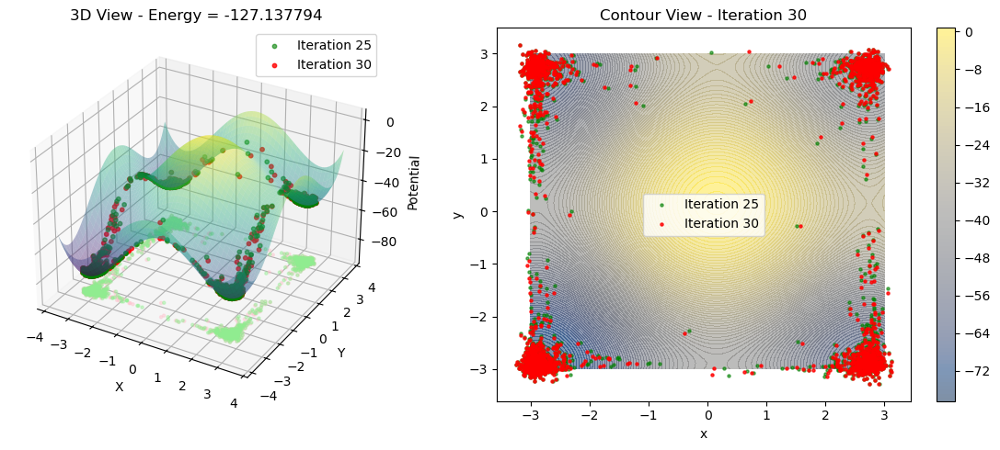

Gradient Flow Progress:  23%|██▎       | 35/149 [02:09<07:01,  3.70s/it, Energy=-128.202194, Linear=-128.522217, Internal=0.320026, Interaction=0.000000]

Iter  35: Energy = -128.202194, Grad norm: 2.18e+01


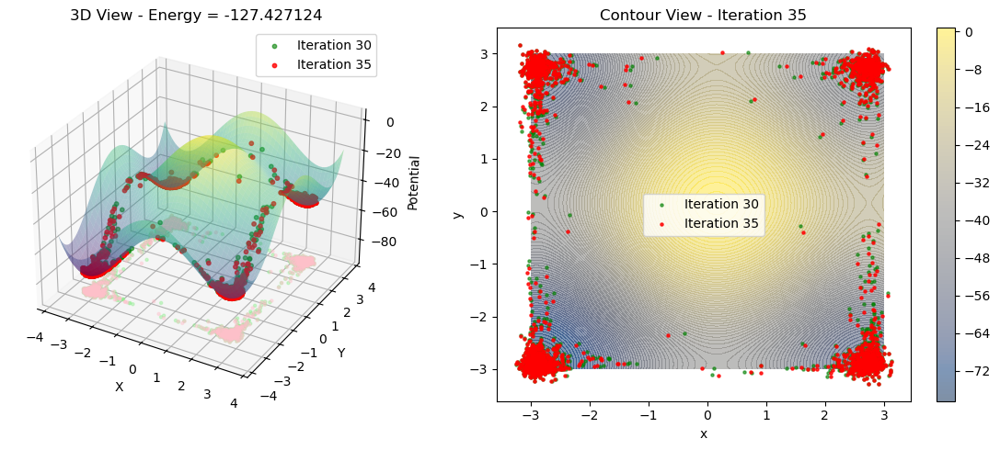

Gradient Flow Progress:  27%|██▋       | 40/149 [02:26<05:59,  3.29s/it, Energy=-128.662521, Linear=-129.102646, Internal=0.440122, Interaction=0.000000]

Iter  40: Energy = -128.662521, Grad norm: 1.00e+01


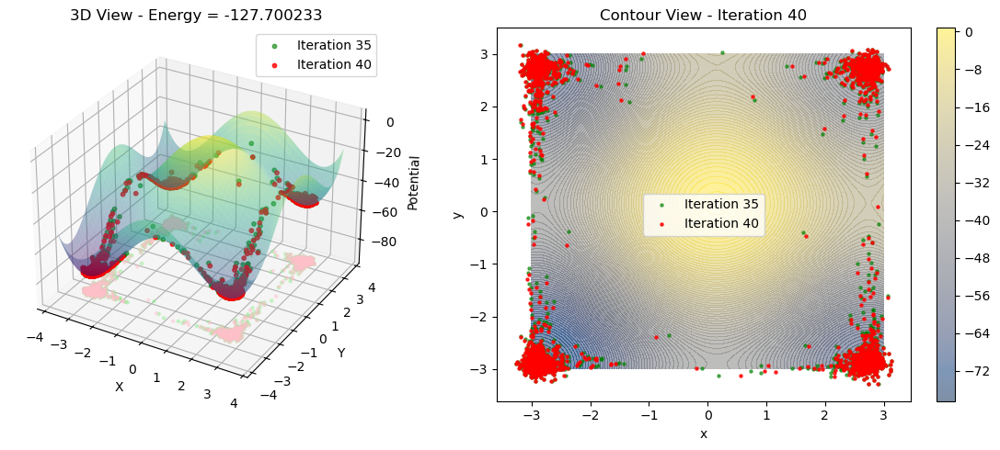

Gradient Flow Progress:  30%|███       | 45/149 [02:42<05:28,  3.16s/it, Energy=-128.536041, Linear=-128.992523, Internal=0.456481, Interaction=0.000000]

Iter  45: Energy = -128.536041, Grad norm: 1.15e+01


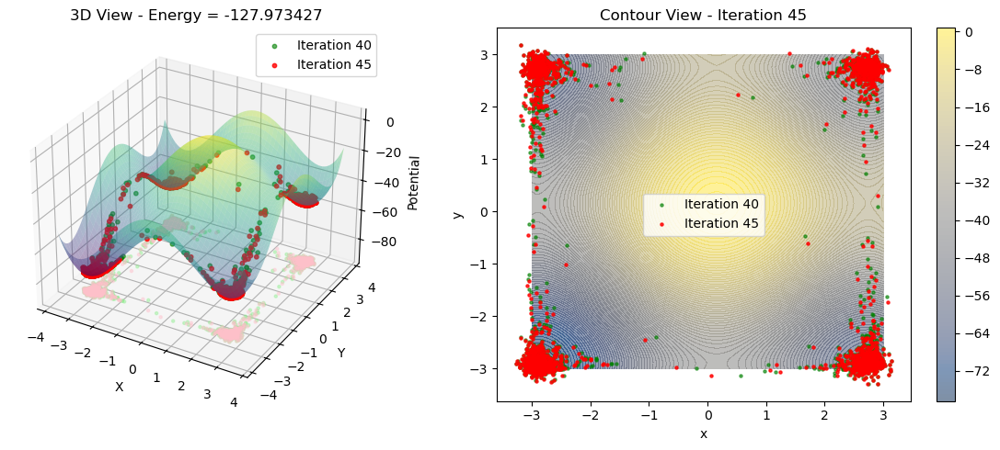

Gradient Flow Progress:  34%|███▎      | 50/149 [02:58<05:11,  3.15s/it, Energy=-128.478745, Linear=-128.949890, Internal=0.471139, Interaction=0.000000]

Iter  50: Energy = -128.478745, Grad norm: 1.71e+01


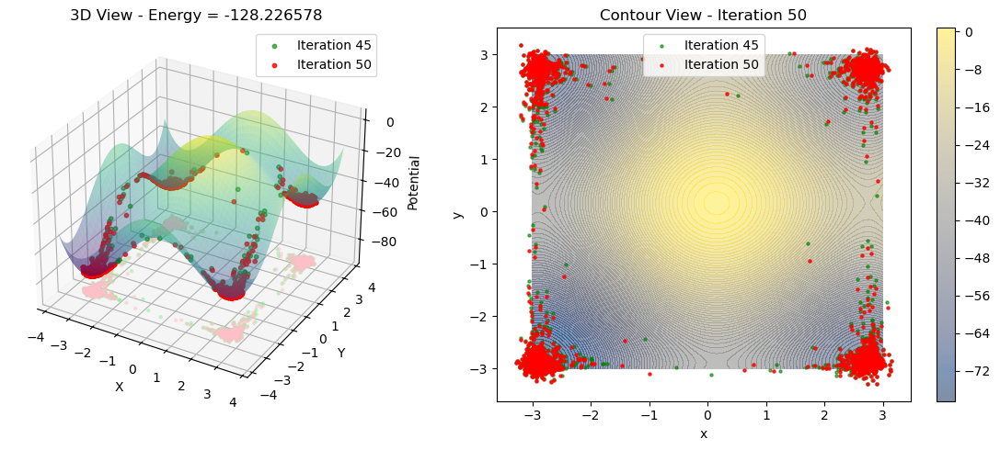

Gradient Flow Progress:  37%|███▋      | 55/149 [03:16<05:12,  3.32s/it, Energy=-128.724411, Linear=-129.220535, Internal=0.496119, Interaction=0.000000]

Iter  55: Energy = -128.724411, Grad norm: 1.08e+01


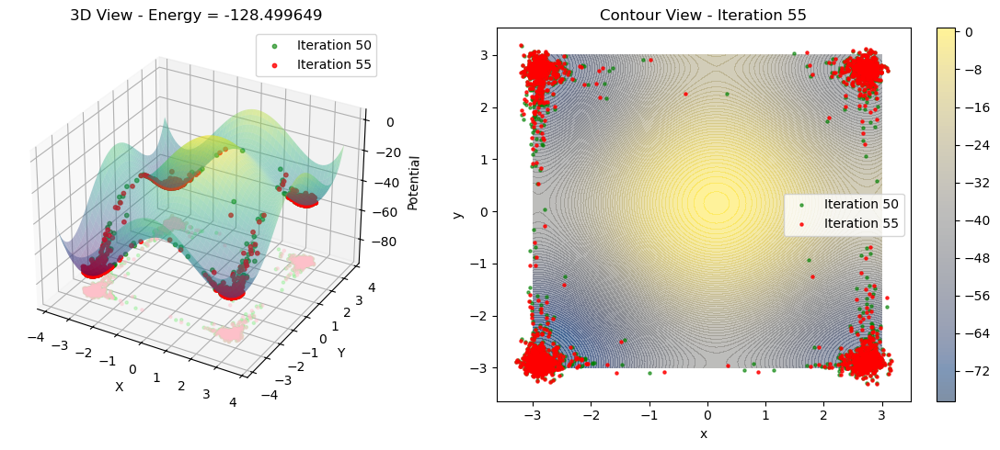

Gradient Flow Progress:  40%|████      | 60/149 [03:34<05:06,  3.45s/it, Energy=-128.955612, Linear=-129.506317, Internal=0.550699, Interaction=0.000000]

Iter  60: Energy = -128.955612, Grad norm: 1.75e+01


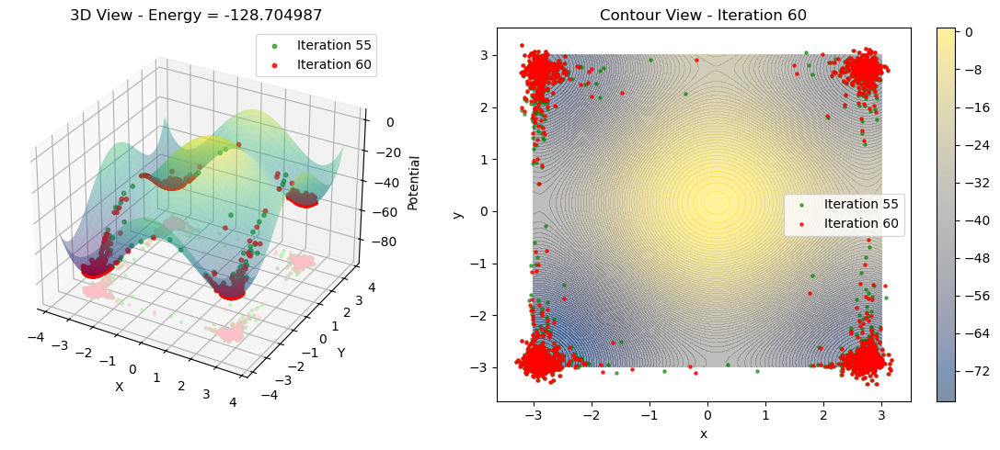

Gradient Flow Progress:  44%|████▎     | 65/149 [03:52<04:43,  3.38s/it, Energy=-130.239471, Linear=-130.858704, Internal=0.619234, Interaction=0.000000]

Iter  65: Energy = -130.239471, Grad norm: 2.37e+01


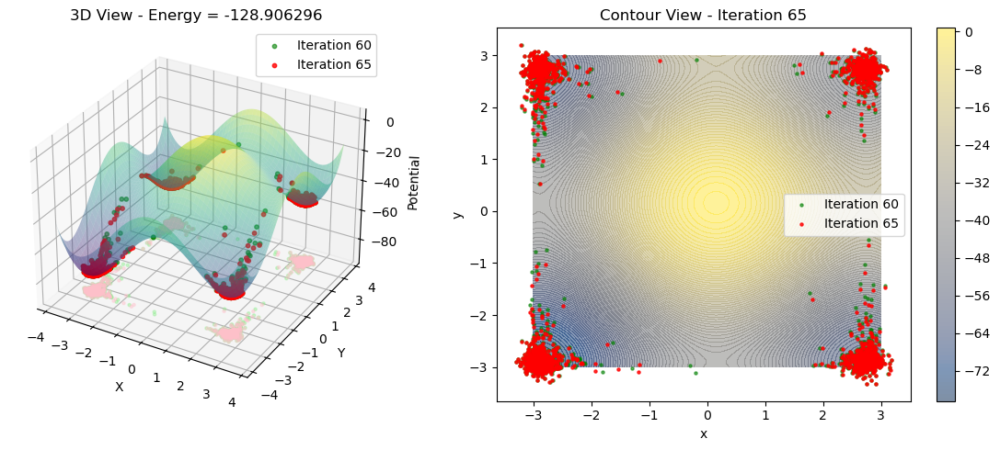

Gradient Flow Progress:  47%|████▋     | 70/149 [04:09<04:21,  3.32s/it, Energy=-128.930969, Linear=-129.589447, Internal=0.658484, Interaction=0.000000]

Iter  70: Energy = -128.930969, Grad norm: 2.41e+01


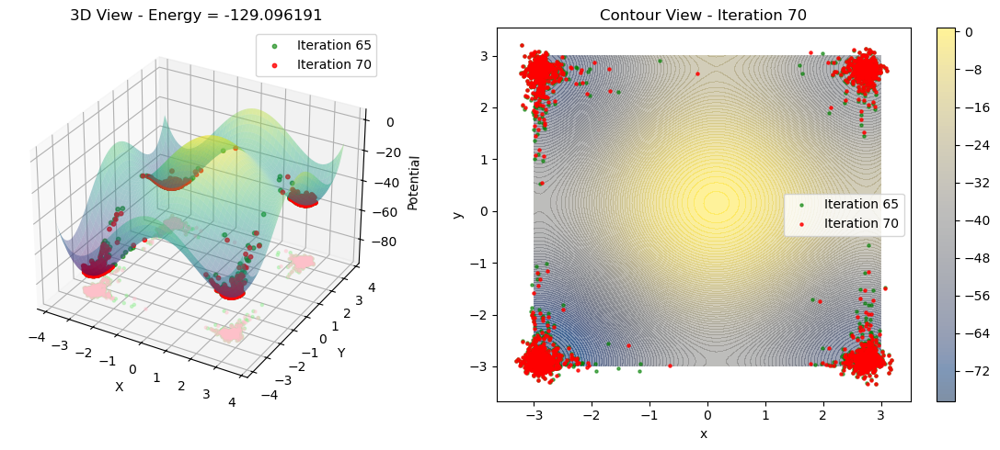

Gradient Flow Progress:  50%|█████     | 75/149 [04:26<04:00,  3.25s/it, Energy=-130.353851, Linear=-131.015564, Internal=0.661712, Interaction=0.000000]

Iter  75: Energy = -130.353851, Grad norm: 1.13e+01


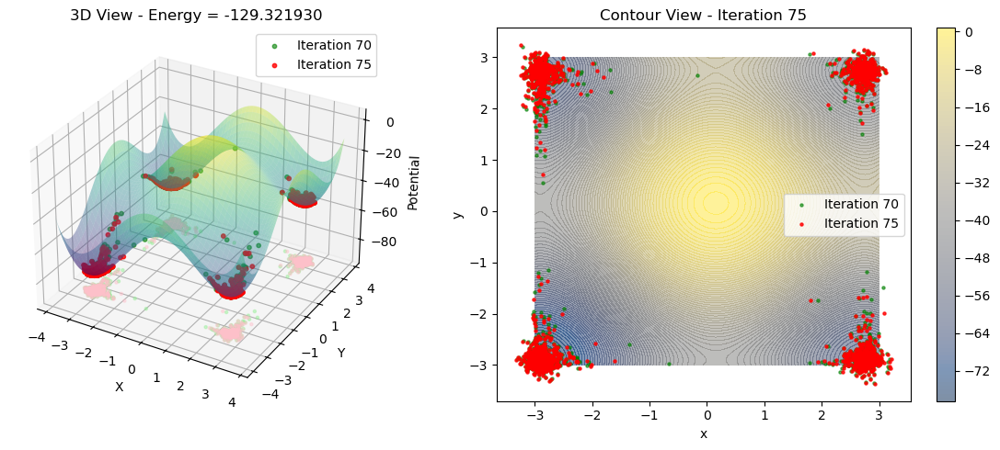

Gradient Flow Progress:  54%|█████▎    | 80/149 [04:42<03:42,  3.22s/it, Energy=-129.035782, Linear=-129.571350, Internal=0.535568, Interaction=0.000000]

Iter  80: Energy = -129.035782, Grad norm: 3.72e+01


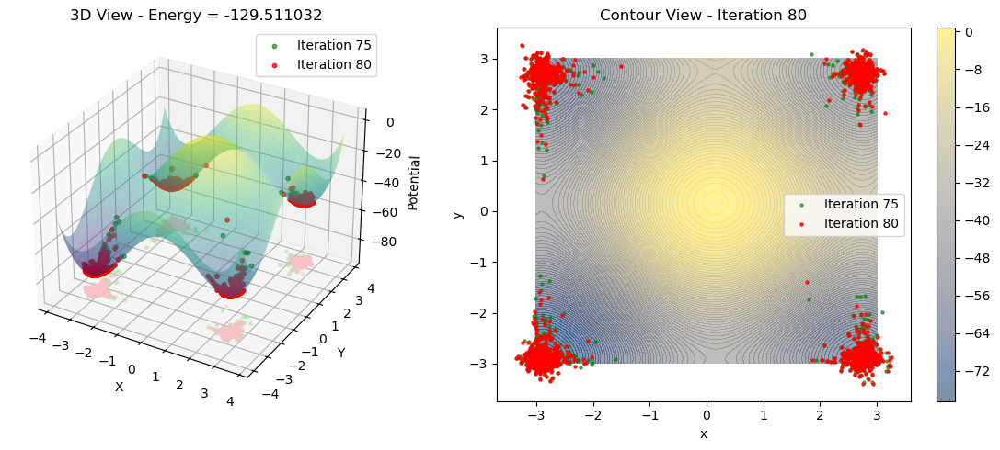

Gradient Flow Progress:  57%|█████▋    | 85/149 [05:00<03:26,  3.23s/it, Energy=-129.398514, Linear=-129.990250, Internal=0.591730, Interaction=0.000000]

Iter  85: Energy = -129.398514, Grad norm: 2.69e+01


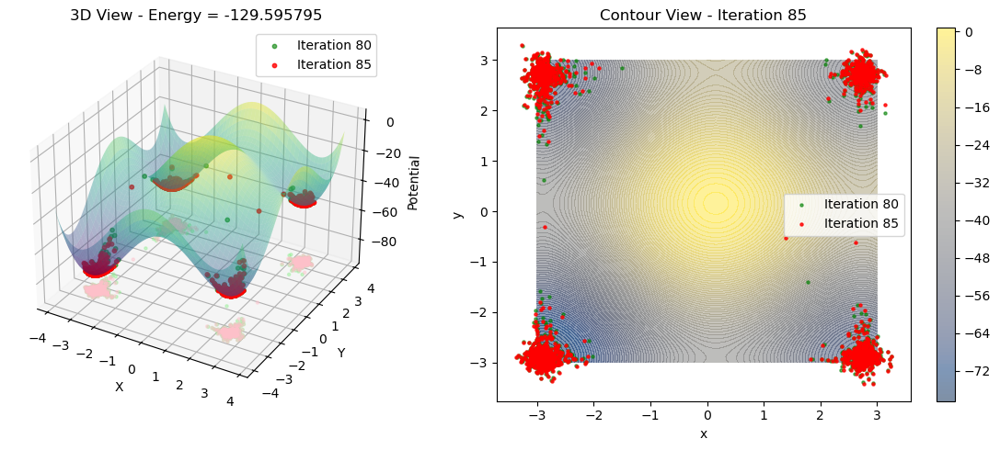

Gradient Flow Progress:  60%|██████    | 90/149 [05:16<03:07,  3.18s/it, Energy=-129.721756, Linear=-130.368805, Internal=0.647051, Interaction=0.000000]

Iter  90: Energy = -129.721756, Grad norm: 5.34e+00


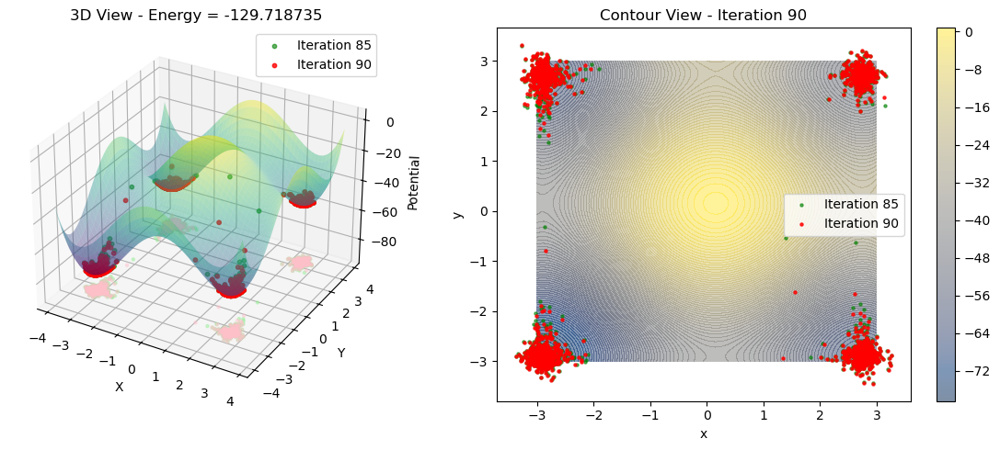

Gradient Flow Progress:  64%|██████▍   | 95/149 [05:33<02:52,  3.19s/it, Energy=-130.594376, Linear=-131.130722, Internal=0.536344, Interaction=0.000000]

Iter  95: Energy = -130.594376, Grad norm: 1.22e+01


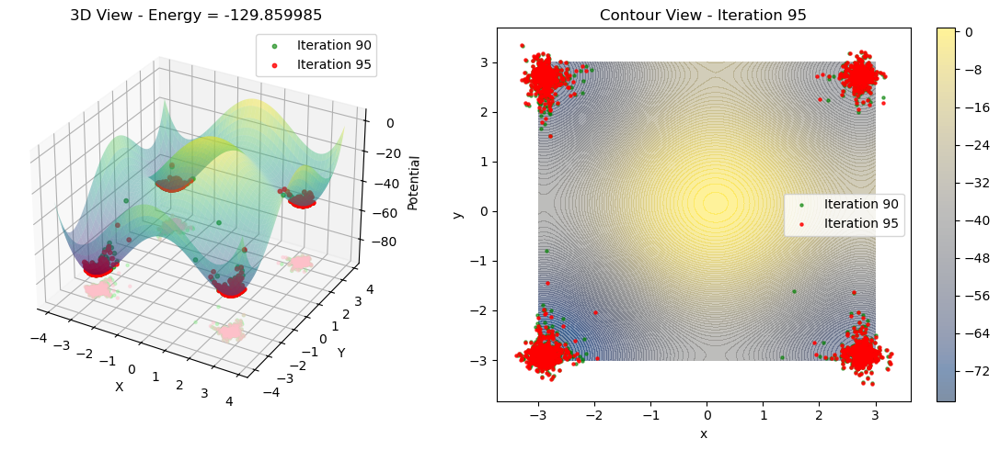

Gradient Flow Progress:  67%|██████▋   | 100/149 [05:49<02:35,  3.17s/it, Energy=-130.724869, Linear=-131.348892, Internal=0.624029, Interaction=0.000000]

Iter 100: Energy = -130.724869, Grad norm: 2.18e+01


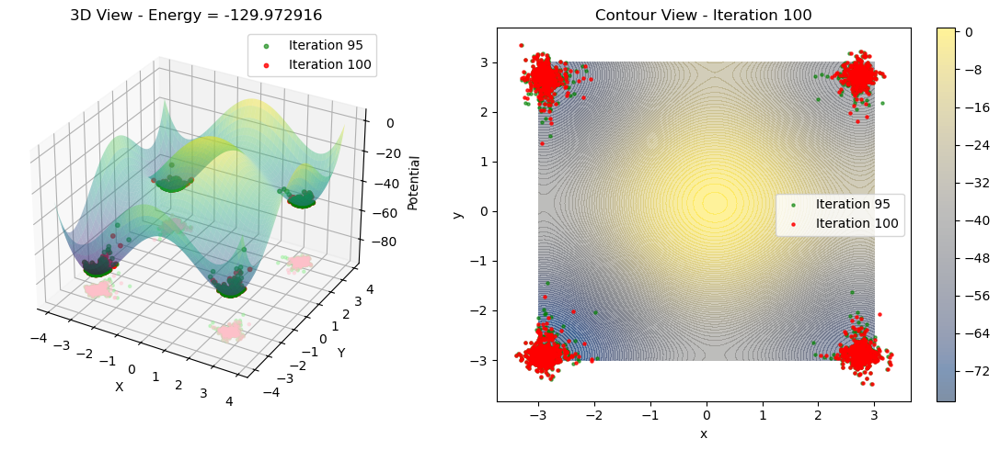

Gradient Flow Progress:  70%|███████   | 105/149 [06:06<02:18,  3.15s/it, Energy=-129.892761, Linear=-130.550674, Internal=0.657915, Interaction=0.000000]

Iter 105: Energy = -129.892761, Grad norm: 4.09e+00


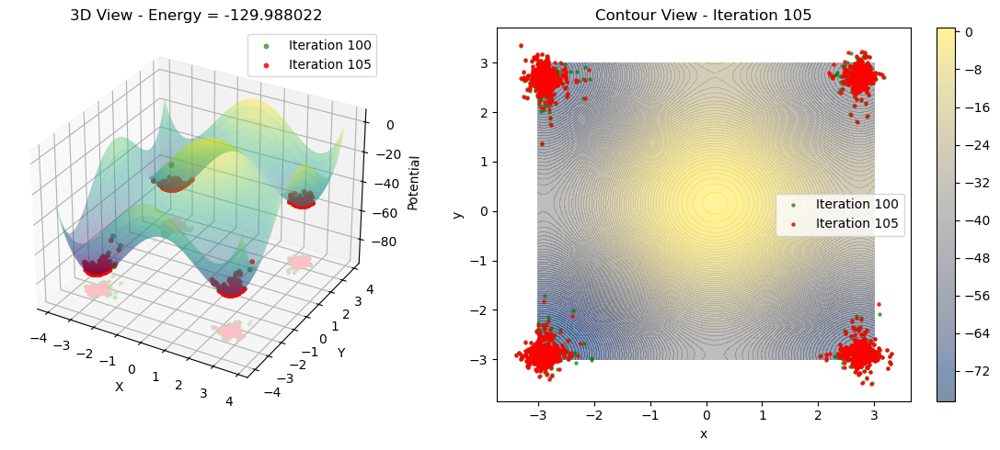

Gradient Flow Progress:  74%|███████▍  | 110/149 [06:25<02:03,  3.17s/it, Energy=-131.120438, Linear=-131.777878, Internal=0.657433, Interaction=0.000000]

Iter 110: Energy = -131.120438, Grad norm: 1.30e+01


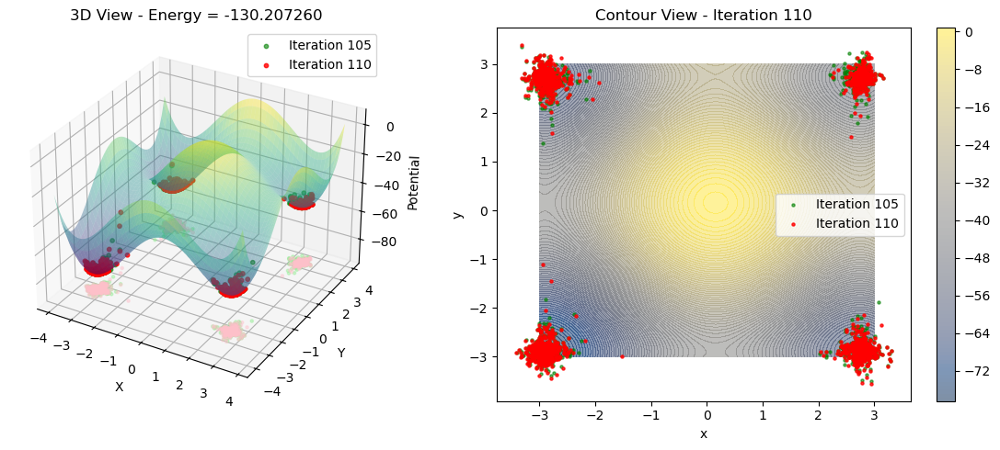

Gradient Flow Progress:  77%|███████▋  | 115/149 [06:42<01:56,  3.43s/it, Energy=-129.720322, Linear=-130.300156, Internal=0.579838, Interaction=0.000000]

Iter 115: Energy = -129.720322, Grad norm: 3.70e+01


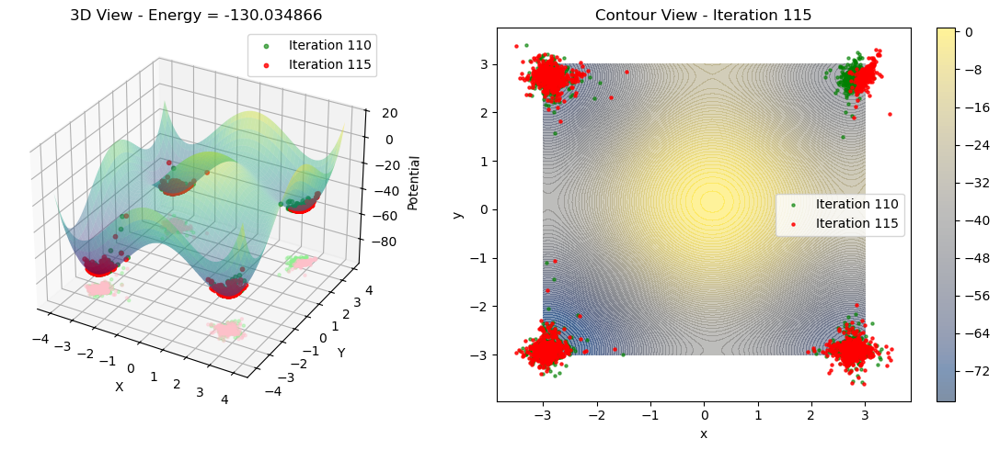

Gradient Flow Progress:  81%|████████  | 120/149 [06:58<01:33,  3.21s/it, Energy=-130.323486, Linear=-130.935150, Internal=0.611659, Interaction=0.000000]

Iter 120: Energy = -130.323486, Grad norm: 1.53e+01


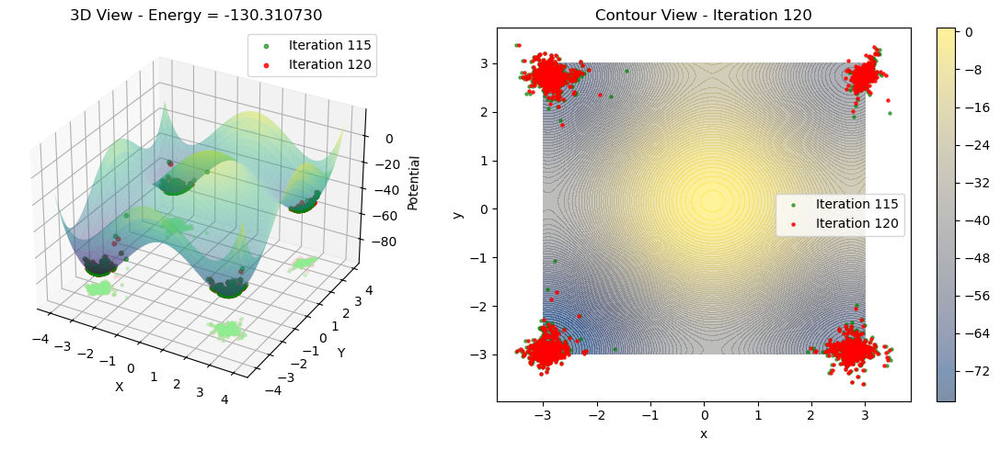

Gradient Flow Progress:  84%|████████▍ | 125/149 [07:15<01:15,  3.16s/it, Energy=-131.768845, Linear=-132.392883, Internal=0.624046, Interaction=0.000000]

Iter 125: Energy = -131.768845, Grad norm: 2.78e+01


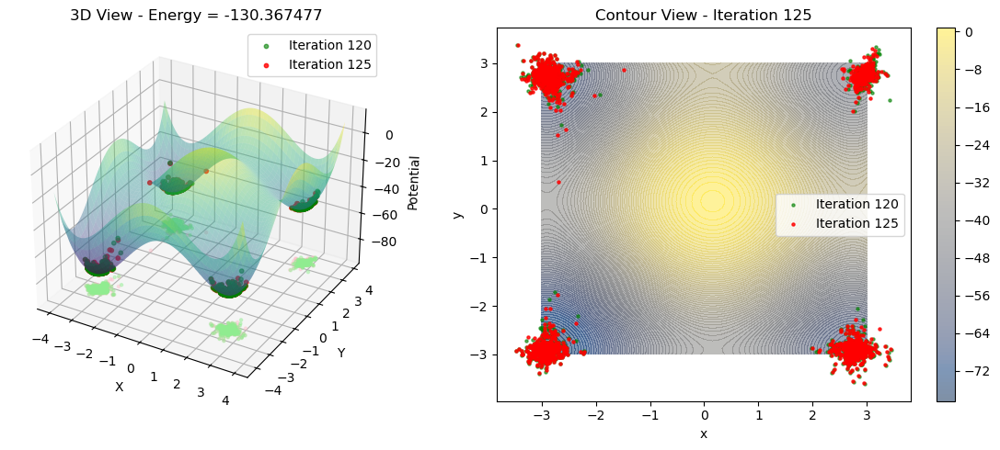

Gradient Flow Progress:  87%|████████▋ | 130/149 [07:32<01:01,  3.22s/it, Energy=-131.287933, Linear=-131.892014, Internal=0.604083, Interaction=0.000000]

Iter 130: Energy = -131.287933, Grad norm: 1.18e+01


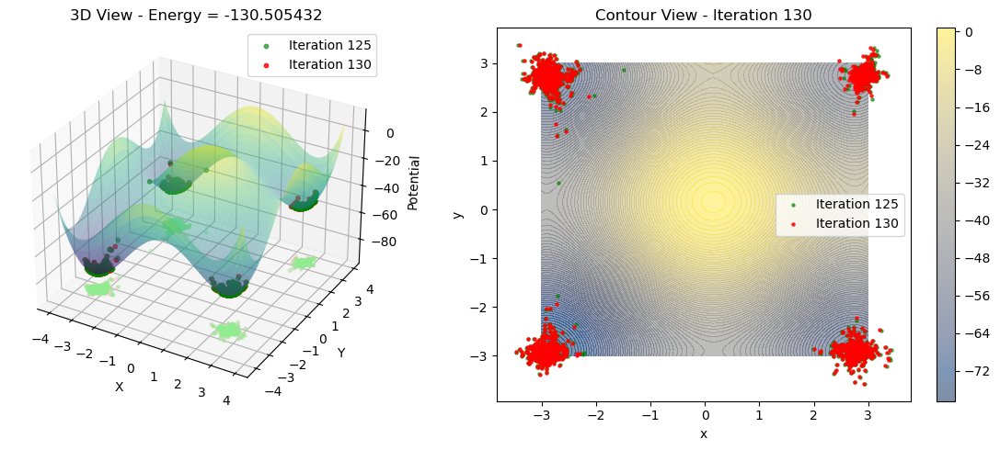

Gradient Flow Progress:  91%|█████████ | 135/149 [07:49<00:46,  3.30s/it, Energy=-130.695602, Linear=-131.387878, Internal=0.692279, Interaction=0.000000]

Iter 135: Energy = -130.695602, Grad norm: 1.62e+01


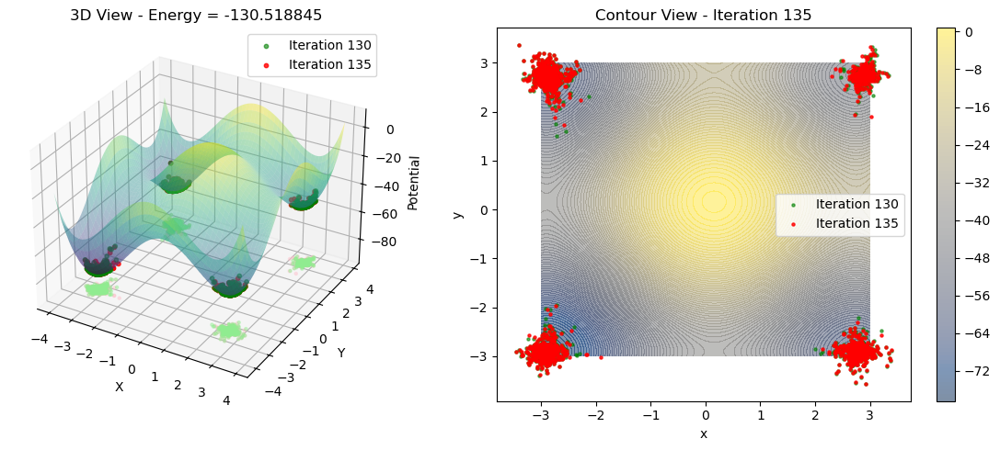

Gradient Flow Progress:  94%|█████████▍| 140/149 [08:07<00:30,  3.36s/it, Energy=-130.244827, Linear=-130.866425, Internal=0.621604, Interaction=0.000000]

Iter 140: Energy = -130.244827, Grad norm: 8.39e+00


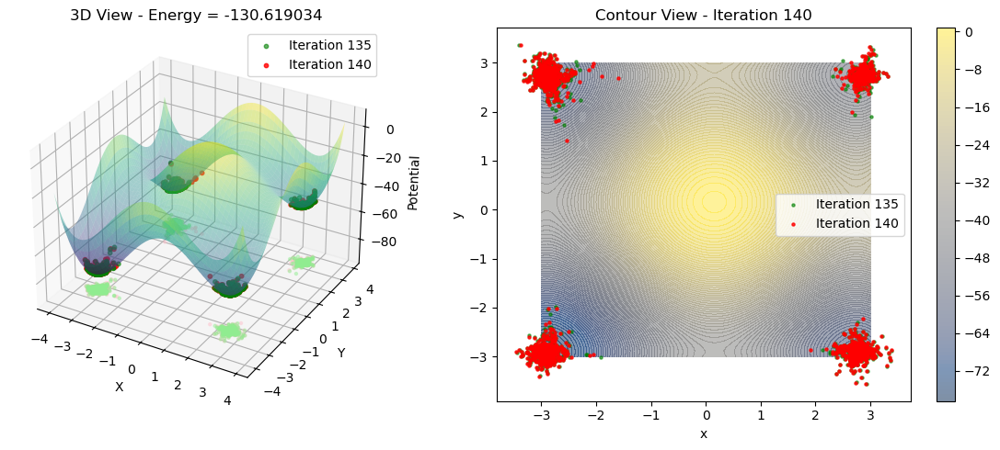

Gradient Flow Progress:  97%|█████████▋| 145/149 [08:25<00:13,  3.47s/it, Energy=-131.319031, Linear=-131.983978, Internal=0.664953, Interaction=0.000000]

Iter 145: Energy = -131.319031, Grad norm: 3.69e+01


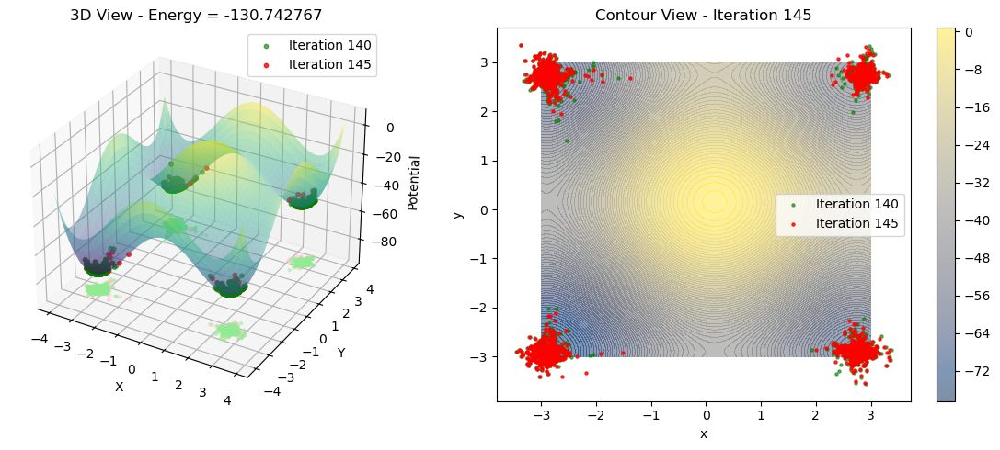

Gradient Flow Progress:  99%|█████████▉| 148/149 [08:36<00:03,  3.56s/it, Energy=-130.566818, Linear=-131.289963, Internal=0.723150, Interaction=0.000000]

Iter 148: Energy = -130.566818, Grad norm: 1.38e+01


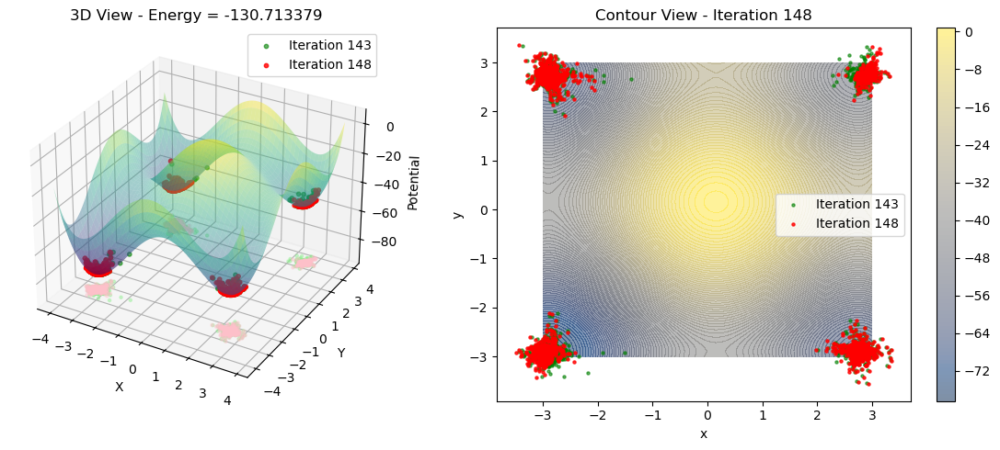

Gradient Flow Progress: 100%|██████████| 149/149 [08:38<00:00,  3.48s/it, Energy=-130.566818, Linear=-131.289963, Internal=0.723150, Interaction=0.000000]


=== Integration Complete ===
Total iterations:    148
Initial energy:      -125.494736
Final energy:        -130.566818
Total decrease:      5.072083
Reduction ratio:     1.0404
Final param norm:    14.620228


In [85]:

results_ = run_gradient_flow(
    final_node, z_samples, G_mat,
    potential,device_idx=device
    ,solver=solver,
    h=h, max_iterations=max_iterations, tolerance=tolerance,
    progress_every=5
)

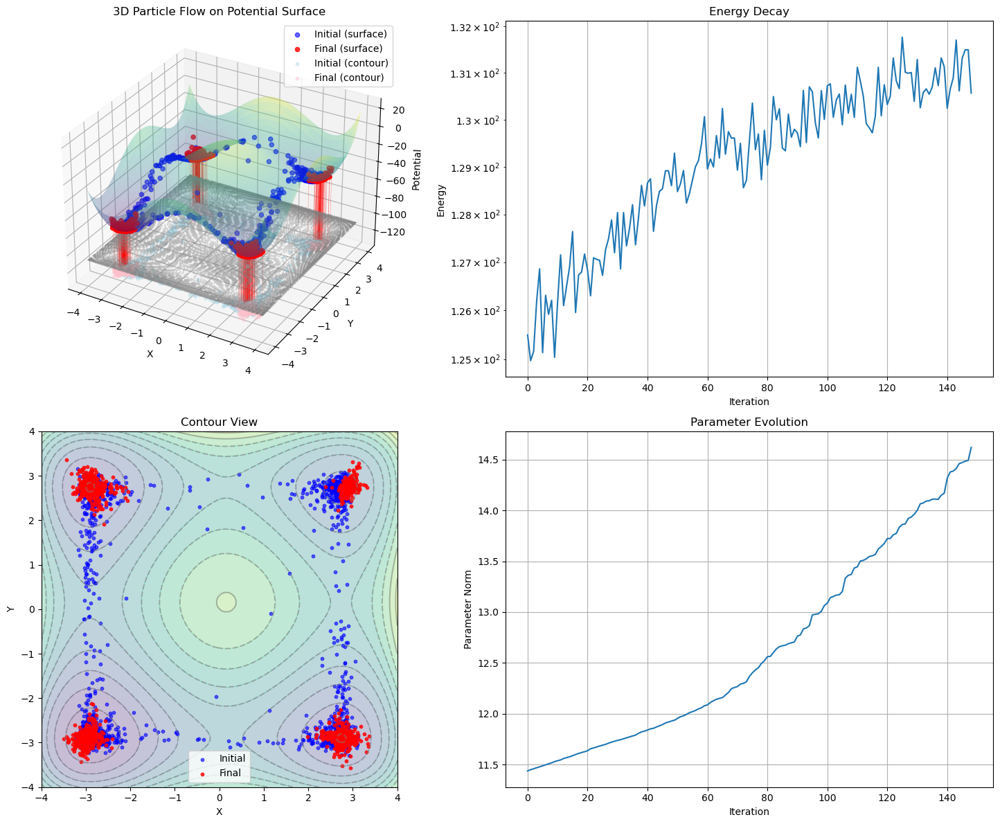

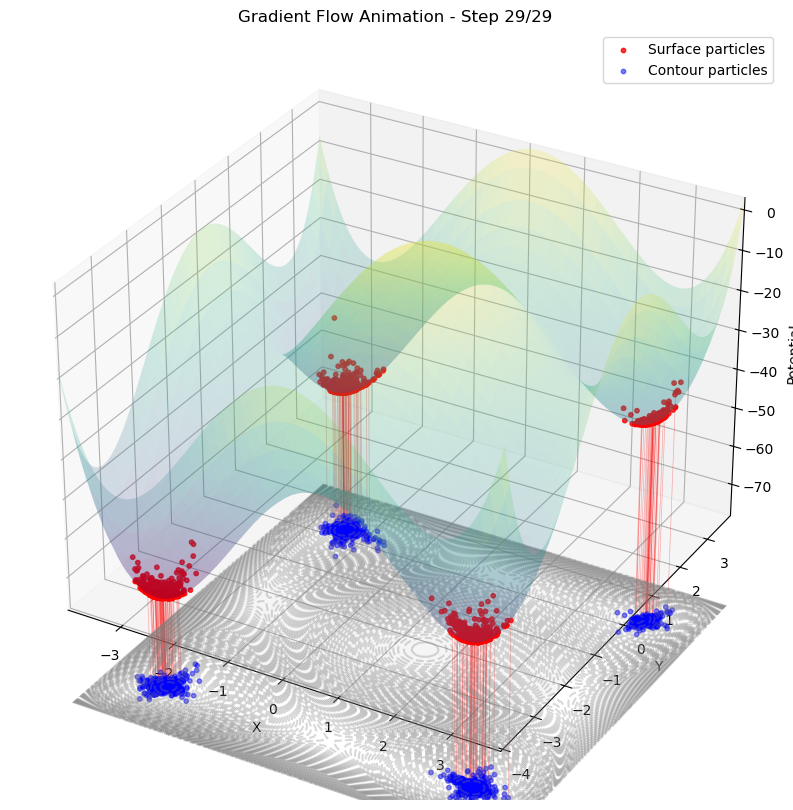

In [87]:
# Example usage:
visualize_gradient_flow_3d(results_, potential,x_range=jnp.linspace(-4,4,100),y_range=jnp.linspace(-4,4,100))  # Simple quadratic potential
anim = animate_gradient_flow_3d(results_, potential, 'flow_animation2.gif')